In [0]:

#Loading the dataset
import pandas as pd
import os
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt

fifaPlayers = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/jrayen@gmu.edu/finalfifaplayers-9.csv")

In [0]:
#Converting Spark Dataframe to pandas
fifaPlayers_pandas = fifaPlayers.toPandas()

In [0]:
#Checking the datatypes
print(fifaPlayers_pandas.dtypes)

#Everything is object, Conversion will be done after complete cleaning of the dataset

Name                  object
Nationality           object
National_Position     object
Club                  object
Club_Position         object
Club_Kit              object
Club_Joining          object
Contract_Expiry       object
Rating                object
Height                object
Weight                object
Preferred_Foot        object
Birth_Date            object
Age                   object
Preferred_Position    object
Work_Rate             object
Weak_foot             object
Skill_Moves           object
Ball_Control          object
Dribbling             object
Marking               object
Sliding_Tackle        object
Standing_Tackle       object
Aggression            object
Reactions             object
Attacking_Position    object
Interceptions         object
Vision                object
Composure             object
Crossing              object
Short_Pass            object
Long_Pass             object
Acceleration          object
Speed                 object
Stamina       

In [0]:
#Checking the number of records and variables.    - > 17591 records and 51 Columns
print(fifaPlayers_pandas.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17591 entries, 0 to 17590
Data columns (total 52 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Name                17591 non-null  object
 1   Nationality         17591 non-null  object
 2   National_Position   1078 non-null   object
 3   Club                17591 non-null  object
 4   Club_Position       17591 non-null  object
 5   Club_Kit            17591 non-null  object
 6   Club_Joining        17591 non-null  object
 7   Contract_Expiry     17591 non-null  object
 8   Rating              17591 non-null  object
 9   Height              17591 non-null  object
 10  Weight              17591 non-null  object
 11  Preferred_Foot      17591 non-null  object
 12  Birth_Date          17591 non-null  object
 13  Age                 17591 non-null  object
 14  Preferred_Position  17591 non-null  object
 15  Work_Rate           17591 non-null  object
 16  Weak_foot           17

In [0]:
#Checking the number of Null values
fifaPlayers_pandas.isnull().sum()

#Lot of Null values with National_Position and so the whole column is dropped

Name                      0
Nationality               0
National_Position     16513
Club                      0
Club_Position             0
Club_Kit                  0
Club_Joining              0
Contract_Expiry           0
Rating                    0
Height                    0
Weight                    0
Preferred_Foot            0
Birth_Date                0
Age                       0
Preferred_Position        0
Work_Rate                 0
Weak_foot                 0
Skill_Moves               0
Ball_Control              0
Dribbling                 0
Marking                   0
Sliding_Tackle            0
Standing_Tackle           0
Aggression                0
Reactions                 0
Attacking_Position        0
Interceptions             0
Vision                    0
Composure                 0
Crossing                  0
Short_Pass                0
Long_Pass                 0
Acceleration              0
Speed                     0
Stamina                   0
Strength            

In [0]:
#Droping the National_Position Column
fifaPlayers_pandas = fifaPlayers_pandas.drop(columns = ['National_Position'], axis = 1)

#Completely all NULL Values are removed

In [0]:
#Lets remove the "cm" substring from the Height column and "kg" from weight column
fifaPlayers_pandas['Height'] = fifaPlayers_pandas['Height'].str.replace('cm','')
fifaPlayers_pandas['Weight'] = fifaPlayers_pandas['Weight'].str.replace('kg','')

In [0]:
#Changing the datatypes accordingly
fifaPlayers_pandas.iloc[:,15:51] = fifaPlayers_pandas.iloc[:,15:51].apply(pd.to_numeric, errors='coerce')
fifaPlayers_pandas.iloc[:,4:10] = fifaPlayers_pandas.iloc[:,4:10].apply(pd.to_numeric, errors='coerce')
fifaPlayers_pandas.iloc[:,12] = fifaPlayers_pandas.iloc[:,12].apply(pd.to_numeric, errors='coerce')
fifaPlayers_pandas.iloc[:,12] = fifaPlayers_pandas.iloc[:,12].apply(pd.to_numeric, errors='coerce')

In [0]:
print(fifaPlayers_pandas.dtypes)

Name                  object
Nationality           object
Club                  object
Club_Position         object
Club_Kit               int64
Club_Joining           int64
Contract_Expiry        int64
Rating                 int64
Height                 int64
Weight                 int64
Preferred_Foot        object
Birth_Date            object
Age                    int64
Preferred_Position    object
Work_Rate             object
Weak_foot              int64
Skill_Moves            int64
Ball_Control           int64
Dribbling              int64
Marking                int64
Sliding_Tackle         int64
Standing_Tackle        int64
Aggression             int64
Reactions              int64
Attacking_Position     int64
Interceptions          int64
Vision                 int64
Composure              int64
Crossing               int64
Short_Pass             int64
Long_Pass              int64
Acceleration           int64
Speed                  int64
Stamina                int64
Strength      

In [0]:
fifaPlayers_pandas_EDA = fifaPlayers_pandas.copy()
# Bar plot for top 10 clubs based on ratings 
# Group by Club and calculate the average rating and number of players
club_stats = fifaPlayers_pandas_EDA.groupby('Club').agg({'Rating': 'mean', 'Name': 'count'}).reset_index()

# Sort the DataFrame by average rating in descending order and select the top 10
top_10_clubs = club_stats.sort_values(by='Rating', ascending=False).head(10)

In [0]:

# Plotting the bar chart with hover information
fig = px.bar(top_10_clubs, x='Club', y='Name', color='Rating',
             labels={'Name': 'Number of Players', 'Rating': 'Average Rating'},
             title='Top 10 Clubs Based on Average Rating',
             height=600,
             hover_data={'Rating': True, 'Name': True})

# Show the plot
fig.show()

In [0]:
# Line graph for Average Rating by Birth Year

# Extracting the birth year from the 'Birth_Date' column
fifaPlayers_pandas_EDA['Birth_Year'] = pd.to_datetime(fifaPlayers_pandas_EDA['Birth_Date']).dt.year

# Calculate age based on the birth year and the current year (2023)
current_year = 2023
fifaPlayers_pandas_EDA['Age'] = current_year - fifaPlayers_pandas_EDA['Birth_Year']

In [0]:

# Group by birth year and calculate the average rating and the number of players
birth_year_stats = fifaPlayers_pandas_EDA.groupby('Birth_Year').agg({'Rating': 'mean', 'Age': 'first', 'Name': 'count'}).reset_index()
birth_year_stats = birth_year_stats.rename(columns={'Name': 'Number_of_Players'})

In [0]:

# Plotting the line graph with points
fig = px.line(birth_year_stats, x='Birth_Year', y='Rating',
              labels={'Rating': 'Average Rating', 'Birth_Year': 'Birth Year'},
              title='Average Rating by Birth Year',
              hover_data={'Birth_Year': True, 'Age': True, 'Rating': True, 'Number_of_Players': True},
              line_shape='linear',  # Connect data points with a line
              markers=True,  # Add points at data values
              height=600)

# Show the plot
fig.show()

# Observe the pattern of the line, observe the ratings of people born in different years. 

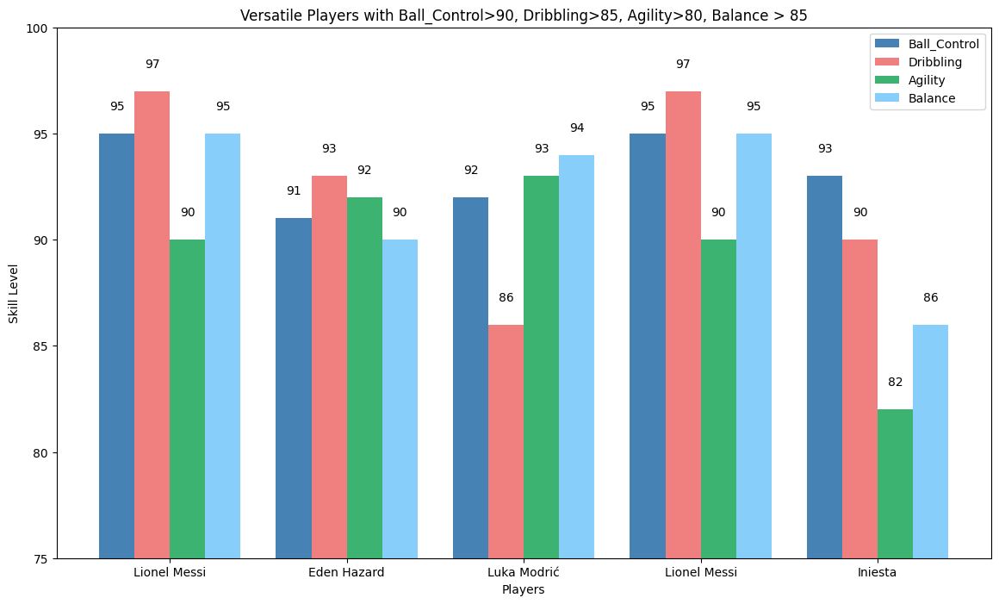

In [0]:


# Filter versatile players based on Ball_Control >90, Dribbling>85, Agility>80, Balance>85 
versatile_players = fifaPlayers_pandas_EDA[
    (fifaPlayers_pandas_EDA['Ball_Control'] > 90) &
    (fifaPlayers_pandas_EDA['Dribbling'] > 85) &
    (fifaPlayers_pandas_EDA['Agility'] > 80) &
    (fifaPlayers_pandas_EDA['Balance'] > 85)
]

# If there are versatile players, create the plot
if not versatile_players.empty:
    # Select relevant columns
    versatile_data = versatile_players[['Name', 'Ball_Control', 'Dribbling', 'Agility', 'Balance']]

    # Set player names as index
    versatile_data.set_index('Name', inplace=True)

    # Plotting side-by-side bars with values on top
    fig, ax = plt.subplots(figsize=(14, 8))
    bar_width = 0.2
    index = range(len(versatile_data))

    colors = ['steelblue', 'lightcoral', 'mediumseagreen', 'lightskyblue']

    for i, skill in enumerate(['Ball_Control', 'Dribbling', 'Agility', 'Balance']):
        bars = ax.bar([pos + bar_width * i for pos in index], versatile_data[skill], width=bar_width, label=skill, color=colors[i])

        # Add values on top of the bars
        for bar in bars:
            yval = bar.get_height()
            ax.text(bar.get_x() + bar.get_width() / 2, yval + 1, round(yval, 2), ha='center', va='bottom')

    ax.set_xlabel('Players')
    ax.set_ylabel('Skill Level')
    ax.set_title('Versatile Players with Ball_Control>90, Dribbling>85, Agility>80, Balance > 85')
    ax.set_xticks([pos + bar_width * 1.5 for pos in index])
    ax.set_xticklabels(versatile_data.index)
    ax.legend()

    plt.ylim(75, 100)  # Set y-axis range
    plt.show()
else:
    print("No versatile players found.")


In [0]:
# identify the top 7 nationalities and group the others into an 'Others' category and obtain the distribution of players as pie chart.

nationality_counts = fifaPlayers_pandas_EDA['Nationality'].value_counts()
top_7_nationalities = nationality_counts.head(7).index
fifaPlayers_pandas_EDA['NationalityGrouped'] = fifaPlayers_pandas_EDA['Nationality'].apply(lambda x: x if x in top_7_nationalities else 'Others')

In [0]:

# Create a pie chart
fig = px.pie(fifaPlayers_pandas_EDA, names='NationalityGrouped', title='Distribution of Players by Nationality')

# Update layout to show only the name when hovering
fig.update_traces(hovertemplate='%{label}')

# Show the plot
fig.show()


In [0]:
#Excluding the unwanted variables
fifaPlayers_pandas = fifaPlayers_pandas.drop(columns = ['Club_Position','Name', 'Nationality','Club','Birth_Date','Preferred_Position', 'Work_Rate'], axis = 1)

In [0]:
fifaPlayers_pandas

,Club_Kit,Club_Joining,Contract_Expiry,Rating,Height,Weight,Preferred_Foot,Age,Weak_foot,Skill_Moves,Ball_Control,Dribbling,Marking,Sliding_Tackle,Standing_Tackle,Aggression,Reactions,Attacking_Position,Interceptions,Vision,Composure,Crossing,Short_Pass,Long_Pass,Acceleration,Speed,Stamina,Strength,Balance,Agility,Jumping,Heading,Shot_Power,Finishing,Long_Shots,Curve,Freekick_Accuracy,Penalties,Volleys,GK_Positioning,GK_Diving,GK_Kicking,GK_Handling,GK_Reflexes
0,7,2009,2021,94,185,80,Right,32,4,5,93,92,22,23,31,63,96,94,29,85,86,84,83,77,91,92,92,80,63,90,95,85,92,93,90,81,76,85,88,14,7,15,11,11
1,10,2004,2018,93,170,72,Left,29,4,4,95,97,13,26,28,48,95,93,22,90,94,77,88,87,92,87,74,59,95,90,68,71,85,95,88,89,90,74,85,14,6,15,11,8
2,11,2013,2021,92,174,68,Right,25,5,5,95,96,21,33,24,56,88,90,36,80,80,75,81,75,93,90,79,49,82,96,61,62,78,89,77,79,84,81,83,15,9,15,9,11
3,9,2014,2021,92,182,85,Right,30,4,4,91,86,30,38,45,78,93,92,41,84,83,77,83,64,88,77,89,76,60,86,69,77,87,94,86,86,84,85,88,33,27,31,25,37
4,1,2011,2021,92,193,92,Right,31,4,1,48,30,10,11,10,29,85,12,30,70,70,15,55,59,58,61,44,83,35,52,78,25,25,13,16,14,11,47,11,91,89,95,90,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17586,30,2016,2020,45,183,82,Right,19,1,1,12,11,12,12,13,25,48,11,12,37,35,12,22,19,25,21,17,52,52,27,56,14,16,13,13,11,13,15,12,39,44,52,41,46
17587,28,2016,2020,45,185,80,Right,19,2,1,13,11,11,12,11,15,43,11,12,27,22,14,27,26,16,19,21,42,45,28,53,12,17,12,11,12,13,16,12,47,39,46,46,46
17588,32,2015,2023,45,173,61,Right,18,2,2,44,39,40,29,35,44,42,43,38,41,35,35,48,42,62,60,64,34,83,54,61,41,44,28,42,35,36,42,37,15,7,13,14,7
17589,45,2016,2017,45,180,80,Right,21,3,1,17,13,11,11,14,23,46,14,12,13,28,15,20,15,42,40,40,61,60,34,48,15,23,14,12,13,12,24,12,40,45,44,43,45


In [0]:
#Transfering to Spark DF
spark_df = spark.createDataFrame(fifaPlayers_pandas)


In [0]:
#Saving the cleaned dataset as a csv file
output_path = "/FileStore/shared_uploads/jrayen@gmu.edu/cleaned_dataset.csv"

# Write the Spark DataFrame to a CSV file
spark_df.write.csv(output_path, header=True, mode="overwrite")

In [0]:
%r
#Importing some Libraries in R
library(dplyr)
library(shiny)
library(tidyr)
library(tidyverse)
library(knitr)
library(ggplot2)
library(SparkR)


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.0     ✔ purrr   1.0.1
✔ tibble  3.1.8     ✔ stringr 1.5.0
✔ readr   2.1.3     ✔ forcats 1.0.0
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()

Attaching package: ‘SparkR’

The following object is masked _by_ ‘.GlobalEnv’:

    setLocalProperty

The following objects are masked from ‘package:purrr’:

    flatten, negate, when

The following object is masked from ‘package:ggplot2’:

    expr

The following object is masked from ‘package:tidyr’:

    contains

The following object is masked from ‘package:shiny’:

    column

The following objects are masked from ‘package:dplyr’:

    arrange, 

In [0]:
%r
file_path <- "dbfs:/FileStore/shared_uploads/jrayen@gmu.edu/cleaned_dataset.csv"

# Read the CSV file into a Spark DataFrame
r_fifaplayers <- read.df(file_path, source = "csv", header = "true", inferSchema = "true")


In [0]:
%r
#Converting Spark dataframe to R dataframe
r_df<-as.data.frame(r_fifaplayers)
class(r_df)

[1] "data.frame"

In [0]:
%r
#Checking the Structure of the dataframe
str(r_df)

'data.frame':	17591 obs. of  44 variables:
 $ Club_Kit          : int  29 28 41 25 7 19 8 1 4 26 ...
 $ Club_Joining      : int  2014 2014 2015 2014 2017 2016 2015 2014 2016 2015 ...
 $ Contract_Expiry   : int  2023 2018 2023 2018 2017 2019 2017 2019 2019 2020 ...
 $ Rating            : int  64 64 64 64 66 64 64 64 64 64 ...
 $ Height            : int  182 175 180 184 171 192 175 188 185 185 ...
 $ Weight            : int  72 70 74 77 70 84 70 80 76 77 ...
 $ Preferred_Foot    : chr  "Left" "Left" "Right" "Right" ...
 $ Age               : int  21 21 18 20 24 22 22 21 27 21 ...
 $ Weak_foot         : int  2 3 3 2 3 3 3 3 3 2 ...
 $ Skill_Moves       : int  2 3 2 2 2 2 4 1 2 3 ...
 $ Ball_Control      : int  56 65 53 64 56 63 65 25 54 60 ...
 $ Dribbling         : int  46 66 45 62 55 49 72 15 52 67 ...
 $ Marking           : int  55 34 65 55 63 12 41 13 61 19 ...
 $ Sliding_Tackle    : int  62 47 61 57 67 18 49 21 63 17 ...
 $ Standing_Tackle   : int  64 45 64 61 73 15 48 16 62 17 ...
 

In [0]:
%r
#Checking the number of NULL values
table(is.na(r_df))


 FALSE 
774004 

In [0]:
%r
#Converting the Prefereed foot column to Factor Variable
r_df$Preferred_Foot = as.factor(r_df$Preferred_Foot)

In [0]:
%r
#Weak Foot and Skill_Moves are converted into Factor Variables
r_df$Weak_foot = as.factor(r_df$Weak_foot)
r_df$Skill_Moves = as.factor(r_df$Skill_Moves)

In [0]:
%r
str(r_df)

'data.frame':	17591 obs. of  44 variables:
 $ Club_Kit          : int  29 28 41 25 7 19 8 1 4 26 ...
 $ Club_Joining      : int  2014 2014 2015 2014 2017 2016 2015 2014 2016 2015 ...
 $ Contract_Expiry   : int  2023 2018 2023 2018 2017 2019 2017 2019 2019 2020 ...
 $ Rating            : int  64 64 64 64 66 64 64 64 64 64 ...
 $ Height            : int  182 175 180 184 171 192 175 188 185 185 ...
 $ Weight            : int  72 70 74 77 70 84 70 80 76 77 ...
 $ Preferred_Foot    : Factor w/ 2 levels "Left","Right": 1 1 2 2 2 2 1 2 2 2 ...
 $ Age               : int  21 21 18 20 24 22 22 21 27 21 ...
 $ Weak_foot         : Factor w/ 5 levels "1","2","3","4",..: 2 3 3 2 3 3 3 3 3 2 ...
 $ Skill_Moves       : Factor w/ 5 levels "1","2","3","4",..: 2 3 2 2 2 2 4 1 2 3 ...
 $ Ball_Control      : int  56 65 53 64 56 63 65 25 54 60 ...
 $ Dribbling         : int  46 66 45 62 55 49 72 15 52 67 ...
 $ Marking           : int  55 34 65 55 63 12 41 13 61 19 ...
 $ Sliding_Tackle    : int  62 47 61 

In [0]:
%r
#Checking the Summary of the dataframe
summary(r_df)

    Club_Kit      Club_Joining  Contract_Expiry     Rating          Height     
 Min.   : 1.00   Min.   :1991   Min.   :2017    Min.   :45.00   Min.   :155.0  
 1st Qu.: 9.00   1st Qu.:2014   1st Qu.:2017    1st Qu.:62.00   1st Qu.:176.0  
 Median :18.00   Median :2015   Median :2019    Median :66.00   Median :181.0  
 Mean   :21.29   Mean   :2015   Mean   :2019    Mean   :66.17   Mean   :181.1  
 3rd Qu.:27.00   3rd Qu.:2016   3rd Qu.:2020    3rd Qu.:71.00   3rd Qu.:186.0  
 Max.   :99.00   Max.   :2017   Max.   :2023    Max.   :94.00   Max.   :207.0  
     Weight       Preferred_Foot      Age        Weak_foot Skill_Moves
 Min.   : 48.00   Left : 4096    Min.   :17.00   1:  146   1:2003     
 1st Qu.: 70.00   Right:13495    1st Qu.:22.00   2: 3768   2:9245     
 Median : 75.00                  Median :25.00   3:10974   3:5385     
 Mean   : 75.25                  Mean   :25.46   4: 2506   4: 918     
 3rd Qu.: 80.00                  3rd Qu.:29.00   5:  197   5:  40     
 Max.   :110.0

In [0]:
%r
#Lets check the correlation among variables and identify the highly correlated ones and remove them to avoid overfitting of the model
corr_df = r_df[,-c(7,9,10)]
corr_matrix <- cor(corr_df)
corr_matrix

                       Club_Kit Club_Joining Contract_Expiry      Rating
Club_Kit            1.000000000  0.095165146     0.077080787 -0.17282126
Club_Joining        0.095165146  1.000000000     0.055945103 -0.18607956
Contract_Expiry     0.077080787  0.055945103     1.000000000  0.04731008
Rating             -0.172821261 -0.186079560     0.047310078  1.00000000
Height             -0.028518483  0.006488401    -0.080523718  0.04600811
Weight             -0.072235124 -0.027232956    -0.052987532  0.13908082
Age                -0.198248300 -0.203969701    -0.118516091  0.45799871
Ball_Control       -0.071204785  0.002376147     0.035266691  0.46370919
Dribbling          -0.028750261  0.034230103     0.048586890  0.36915911
Marking            -0.105434624 -0.086050322     0.015509769  0.23611598
Sliding_Tackle     -0.094856386 -0.074174510     0.011591819  0.21485289
Standing_Tackle    -0.104396979 -0.076082381     0.008406124  0.24871644
Aggression         -0.121621797 -0.054770284    -0.

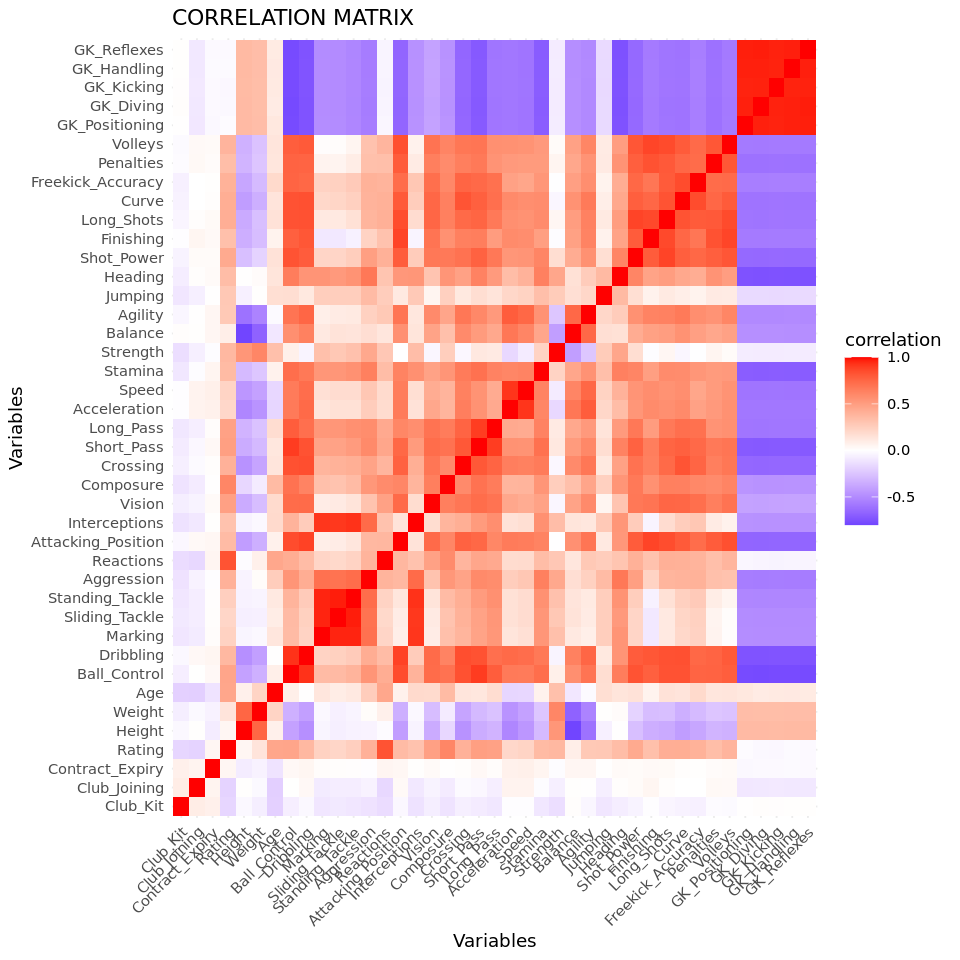

In [0]:
%r
#Creating the correlation plot
ggplot(data = reshape2::melt(corr_matrix)) + 
geom_tile(aes(x = Var1, y = Var2, fill = value)) + 
scale_fill_gradient2(low = "blue", mid = "white", high = "red", midpoint = 0) +
theme_minimal() + 
labs(x = 'Variables',y = 'Variables',title = 'CORRELATION MATRIX',fill = 'correlation') +
theme(axis.text.x = element_text(angle = 45, hjust = 1))

In [0]:
%r
#Getting the correlation with values greater than 0.7(positive correlation) and less than 0.7 (negative correlation)
high_corr_values <- which(corr_matrix > 0.7 & corr_matrix < 1, arr.ind = TRUE)
low_corr_values <- which(corr_matrix < -0.7 & corr_matrix > -1, arr.ind = TRUE)


In [0]:
%r
# Displaying the results - Positive correlation
cat("High correlation values:\n")
for (i in 1:nrow(high_corr_values)) {
  row_index <- high_corr_values[i, 1]
  col_index <- high_corr_values[i, 2]
  cat(paste0(rownames(corr_matrix)[row_index], ", ", colnames(corr_matrix)[col_index], " : ", corr_matrix[row_index, col_index], "\n"))
}


High correlation values:
Reactions, Rating : 0.828568520171958
Weight, Height : 0.758238724562052
Height, Weight : 0.758238724562052
Dribbling, Ball_Control : 0.931155547822584
Attacking_Position, Ball_Control : 0.855574449147834
Vision, Ball_Control : 0.732688066580099
Composure, Ball_Control : 0.704917871260721
Crossing, Ball_Control : 0.838826304273235
Short_Pass, Ball_Control : 0.904453825733696
Long_Pass, Ball_Control : 0.793175305527932
Stamina, Ball_Control : 0.724692778566123
Shot_Power, Ball_Control : 0.829918210803427
Finishing, Ball_Control : 0.781339400455409
Long_Shots, Ball_Control : 0.831922836116849
Curve, Ball_Control : 0.832073935652158
Freekick_Accuracy, Ball_Control : 0.763412761759123
Penalties, Ball_Control : 0.767896786278037
Volleys, Ball_Control : 0.789407254750716
Ball_Control, Dribbling : 0.931155547822584
Attacking_Position, Dribbling : 0.888461395691331
Vision, Dribbling : 0.736363287400645
Crossing, Dribbling : 0.848914838134333
Short_Pass, Dribbling : 0.8

In [0]:
%r
# Displaying the results - Negative correlation
cat("Negative correlation values:\n")
for (i in 1:nrow(low_corr_values)) {
  row_index <- low_corr_values[i, 1]
  col_index <- low_corr_values[i, 2]
  cat(paste0(rownames(corr_matrix)[row_index], ", ", colnames(corr_matrix)[col_index], " : ", corr_matrix[row_index, col_index], "\n"))
}


Negative correlation values:
Balance, Height : -0.799887091828319
GK_Positioning, Ball_Control : -0.775975882554653
GK_Diving, Ball_Control : -0.779838779624708
GK_Kicking, Ball_Control : -0.775562634301806
GK_Handling, Ball_Control : -0.775532778651646
GK_Reflexes, Ball_Control : -0.777598179852229
GK_Positioning, Dribbling : -0.741654441950809
GK_Diving, Dribbling : -0.743773164342274
GK_Kicking, Dribbling : -0.739873349826067
GK_Handling, Dribbling : -0.74052397282933
GK_Reflexes, Dribbling : -0.742005781051605
GK_Positioning, Short_Pass : -0.714305678561146
GK_Diving, Short_Pass : -0.717506836554026
GK_Kicking, Short_Pass : -0.713749449147253
GK_Handling, Short_Pass : -0.713991664673499
GK_Reflexes, Short_Pass : -0.716777134122775
GK_Positioning, Stamina : -0.702161818629222
GK_Diving, Stamina : -0.705670760289026
GK_Kicking, Stamina : -0.702006563934568
GK_Handling, Stamina : -0.703372390380782
GK_Reflexes, Stamina : -0.705192268622377
Height, Balance : -0.799887091828319
GK_Posit

Lets have 2 datasets one with all the variables and another one with variables other than the correlated ones

In [0]:
%r
#New dataset after removing correlated variables
#  1) GKPositioning is kept and GK_Diving	GK_Kicking	GK_Handling	GK_Reflexes are removed
#  2) Standing_Tackle is kept and Sliding_Tacke is removed
#  3) Short_Pass is removed and Long_Pass is kept
#  4) Acceleration is removed and Speed is kept
#  5) Marking is removed
#  6) Ball Control is removed and Dribbling is kept
#  7) Interception is removed and Standing_Tackle is kept
#  8) Balance is removed and Height is kept
#  9) Removing Reactions
# 10) Dribbling, Finishing, Long_Shots, Curve, Volleys are removed and Attacking_Position is kept
# 11) Weight is removed and Height is kept
# 12) Heading is removed
# 13) Vision, Crossing, Shot_Power, Freekick_Accuracy, Penalties are removed and Attacking_Position is kept
# 14) Agility is removed and Speed is kept
# 15) Aggression column is also removed from the dataset

dataset_removedCorr = r_df[,-c(41,42,43,44,14,23,25,13,11,19,29,17,12,34,35,36,39,6,32,20,22,33,37,38,30,16)]
str(dataset_removedCorr)

'data.frame':	17591 obs. of  18 variables:
 $ Club_Kit          : int  29 28 41 25 7 19 8 1 4 26 ...
 $ Club_Joining      : int  2014 2014 2015 2014 2017 2016 2015 2014 2016 2015 ...
 $ Contract_Expiry   : int  2023 2018 2023 2018 2017 2019 2017 2019 2019 2020 ...
 $ Rating            : int  64 64 64 64 66 64 64 64 64 64 ...
 $ Height            : int  182 175 180 184 171 192 175 188 185 185 ...
 $ Preferred_Foot    : Factor w/ 2 levels "Left","Right": 1 1 2 2 2 2 1 2 2 2 ...
 $ Age               : int  21 21 18 20 24 22 22 21 27 21 ...
 $ Weak_foot         : Factor w/ 5 levels "1","2","3","4",..: 2 3 3 2 3 3 3 3 3 2 ...
 $ Skill_Moves       : Factor w/ 5 levels "1","2","3","4",..: 2 3 2 2 2 2 4 1 2 3 ...
 $ Standing_Tackle   : int  64 45 64 61 73 15 48 16 62 17 ...
 $ Attacking_Position: int  45 58 41 55 51 65 60 7 32 58 ...
 $ Composure         : int  45 61 49 52 68 49 59 32 59 50 ...
 $ Long_Pass         : int  47 59 55 61 53 33 63 21 55 36 ...
 $ Speed             : int  73 72 67 7

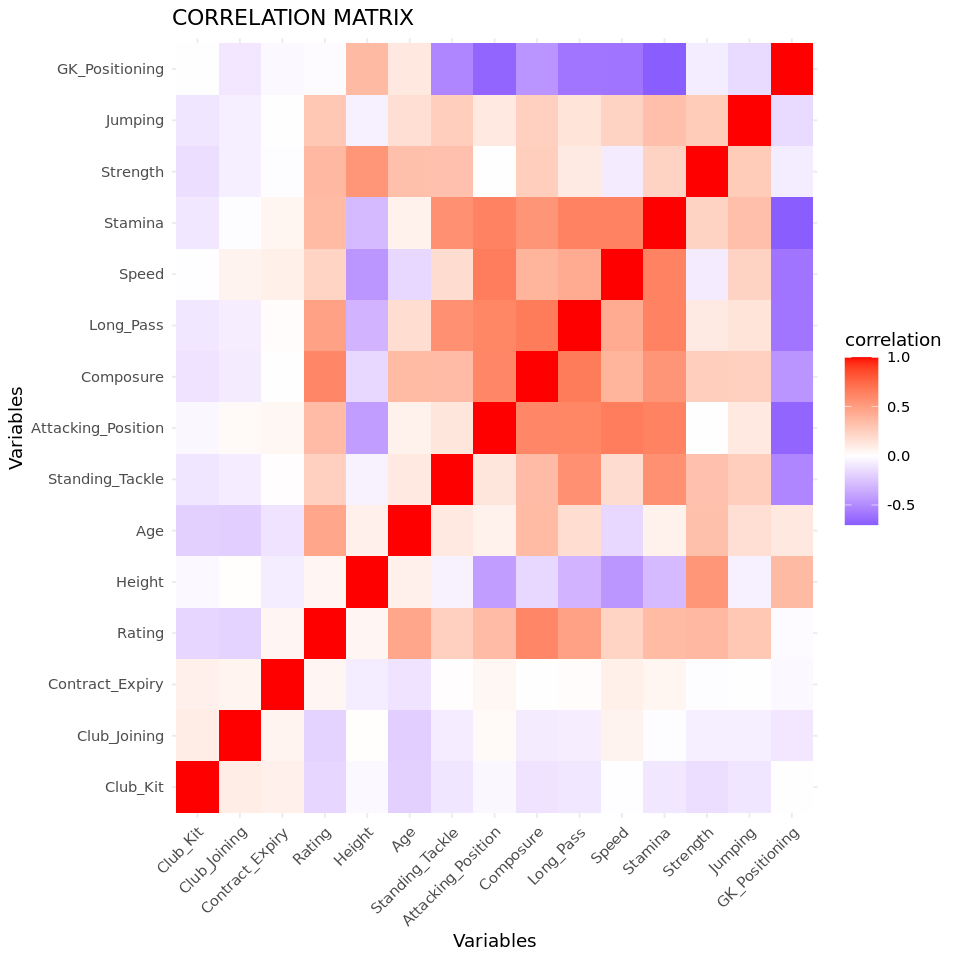

In [0]:
%r
corr_df = r_df[,-c(7,9,10,41,42,43,44,14,23,25,13,11,19,29,17,12,34,35,36,39,6,32,20,22,33,37,38,30,16)]
corr_matrix <- cor(corr_df)

#Creating the correlation plot
ggplot(data = reshape2::melt(corr_matrix)) + 
geom_tile(aes(x = Var1, y = Var2, fill = value)) + 
scale_fill_gradient2(low = "blue", mid = "white", high = "red", midpoint = 0) +
theme_minimal() + 
labs(x = 'Variables',y = 'Variables',title = 'CORRELATION MATRIX',fill = 'correlation') +
theme(axis.text.x = element_text(angle = 45, hjust = 1))

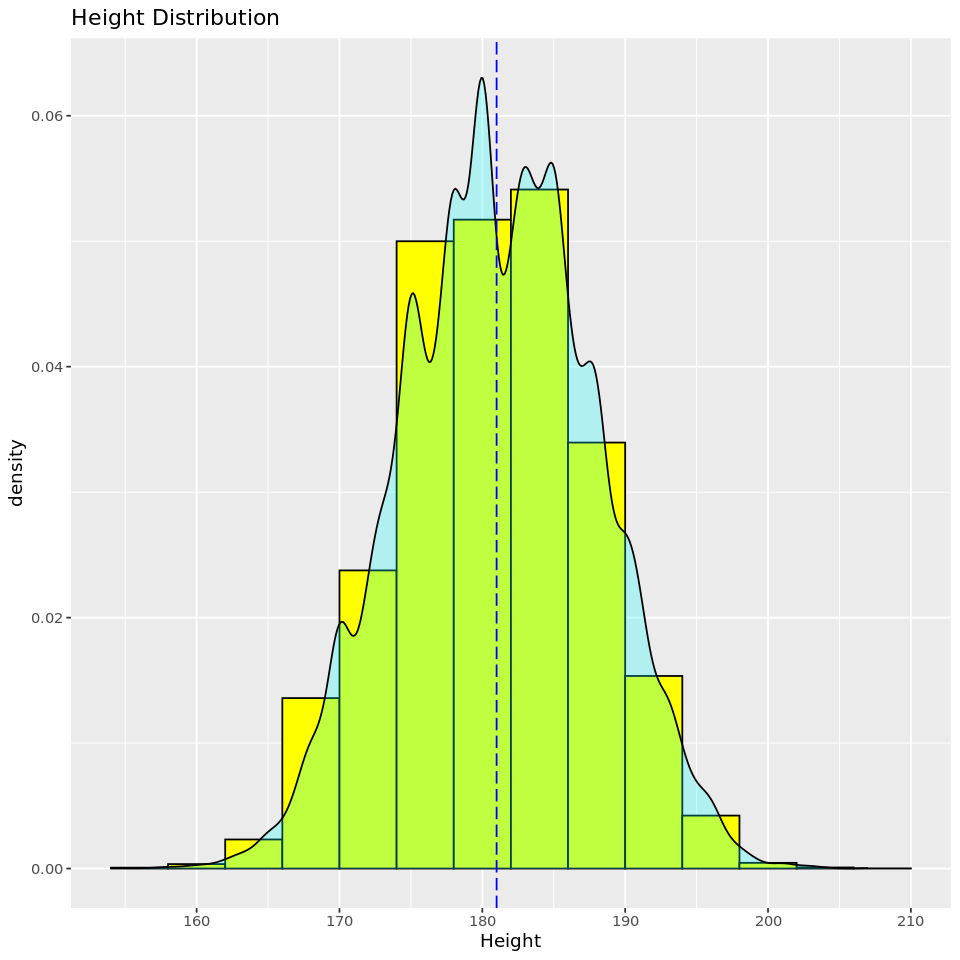

ℹ Please use `after_stat(density)` instead.

In [0]:
%r
#Distribution of Numerical values of the dataset to check for outliers, etc
# Distribution of Height

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Height)) + 
  geom_histogram(aes(y = ..density..), binwidth = 4, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) +
  geom_vline(xintercept = median(dataset_removedCorr$Height), linetype = "longdash", colour = "blue") +
  labs(
    x = "Height",
    y = "density",
    title = "Height Distribution"
  )
p1

#We have Equal distribution over here

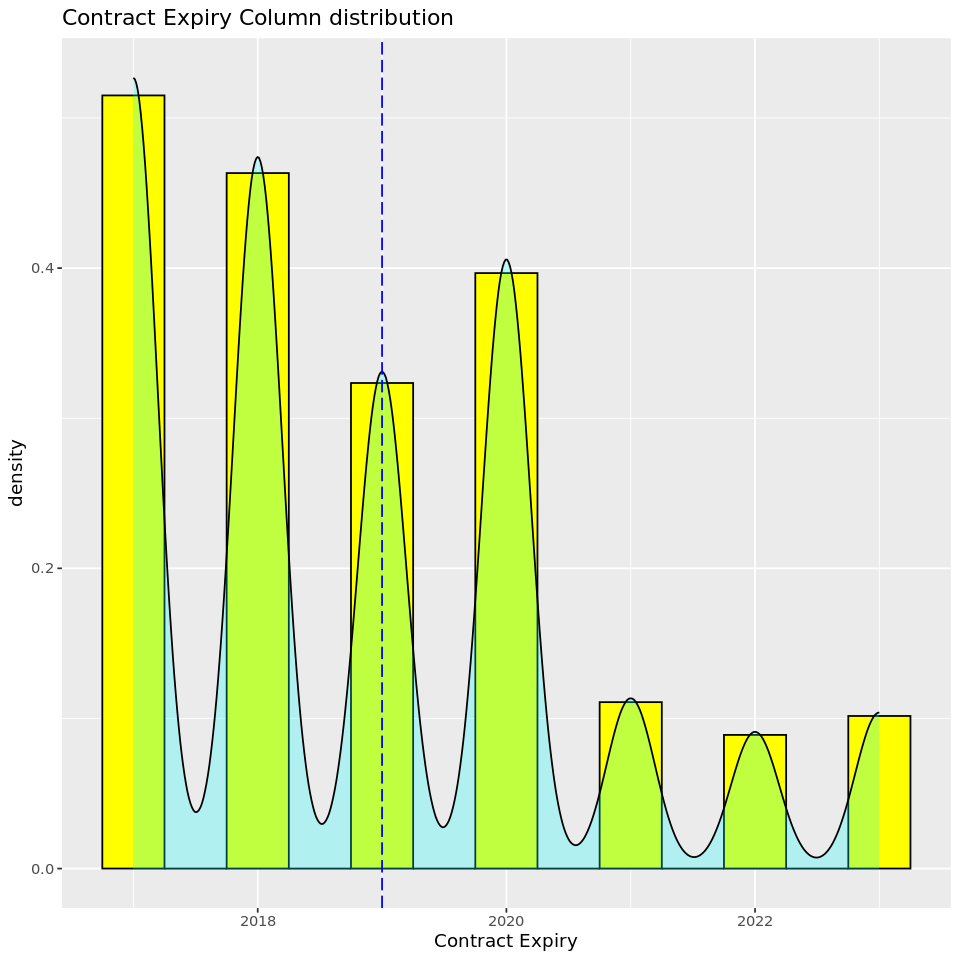

In [0]:
%r
# Distribution of Contract Expiry

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Contract_Expiry)) + 
  geom_histogram(aes(y = ..density..), binwidth = 0.5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Contract_Expiry), linetype = "longdash", colour = "blue") +
  labs(
    x = "Contract Expiry",
    y = "density",
    title = "Contract Expiry Column distribution"
  )
p1

#We have Equal distribution over here as well

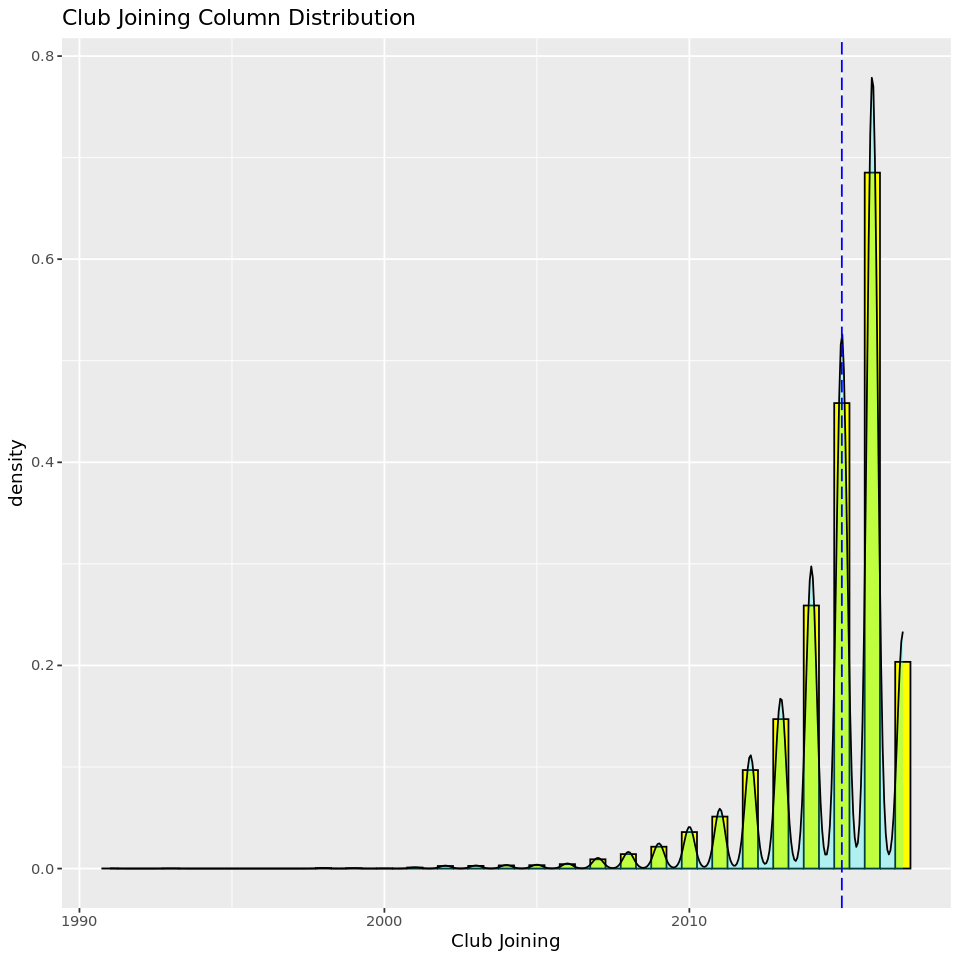

In [0]:
%r
# Distribution of Club Joining Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Club_Joining)) + 
  geom_histogram(aes(y = ..density..), binwidth = 0.5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Club_Joining), linetype = "longdash", colour = "blue") +
  labs(
    x = "Club Joining",
    y = "density",
    title = "Club Joining Column Distribution"
  )
p1

#We don't have equal distribution over here, There are some values which appear at the range of 1990 to 2010 which can effect the modeling chart as well

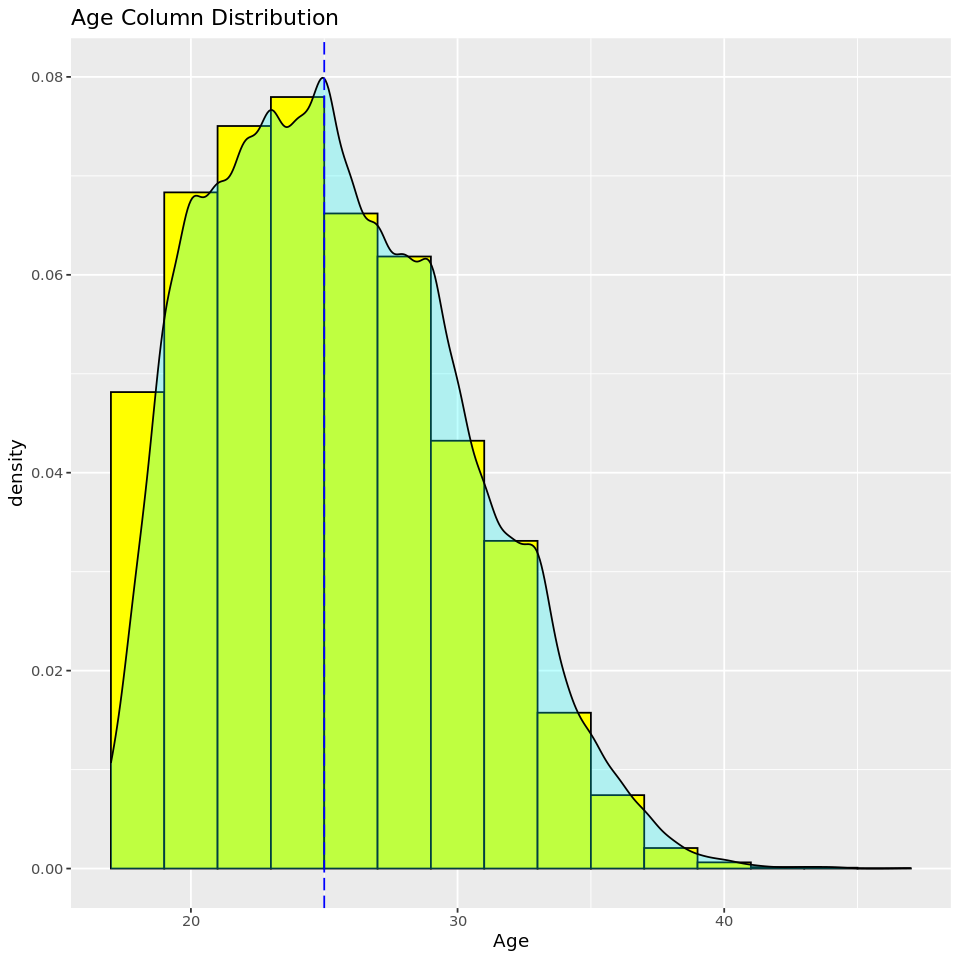

In [0]:
%r
# Distribution of Age Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Age)) + 
  geom_histogram(aes(y = ..density..), binwidth = 2, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Age), linetype = "longdash", colour = "blue") +
  labs(
    x = "Age",
    y = "density",
    title = "Age Column Distribution"
  )
p1

#We have equal distribution over here

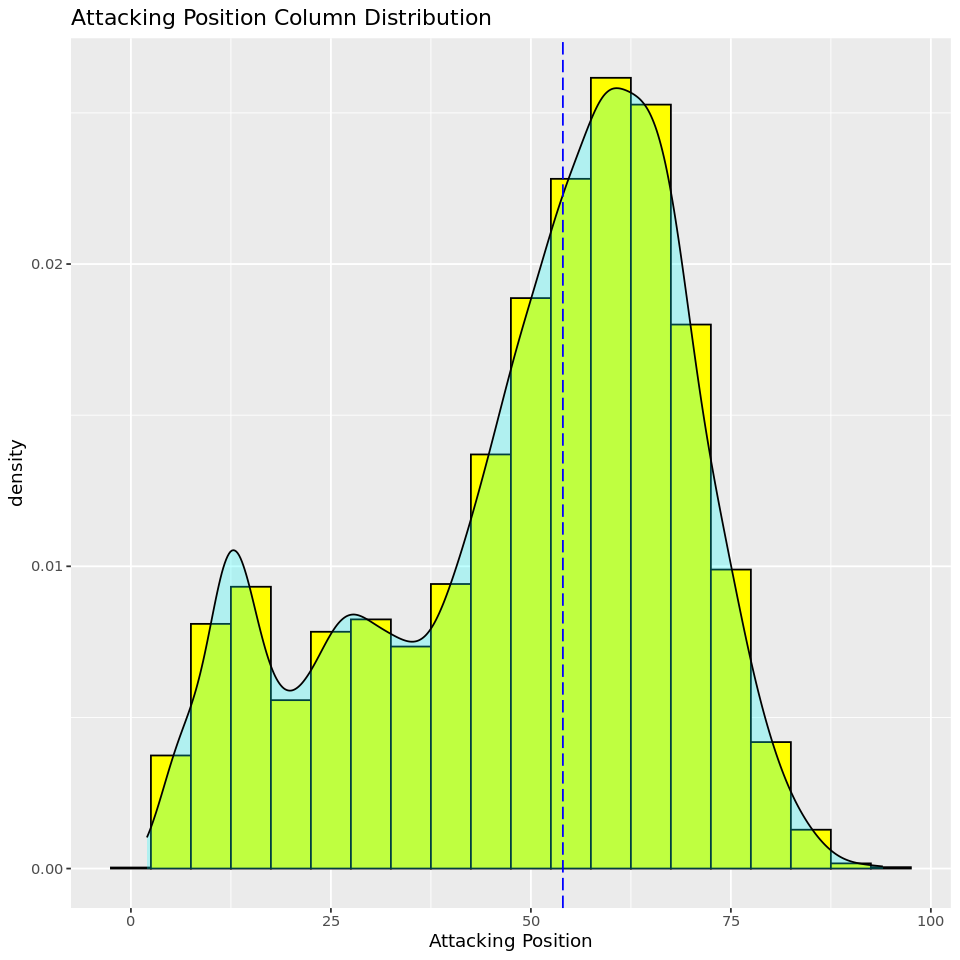

In [0]:
%r
# Distribution of Atatcking Position Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Attacking_Position)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Attacking_Position), linetype = "longdash", colour = "blue") +
  labs(
    x = "Attacking Position",
    y = "density",
    title = "Attacking Position Column Distribution"
  )
p1

#We have equal distribution over here as well. The skewness is expected to be less, Lets have a whole skewness check at the end.

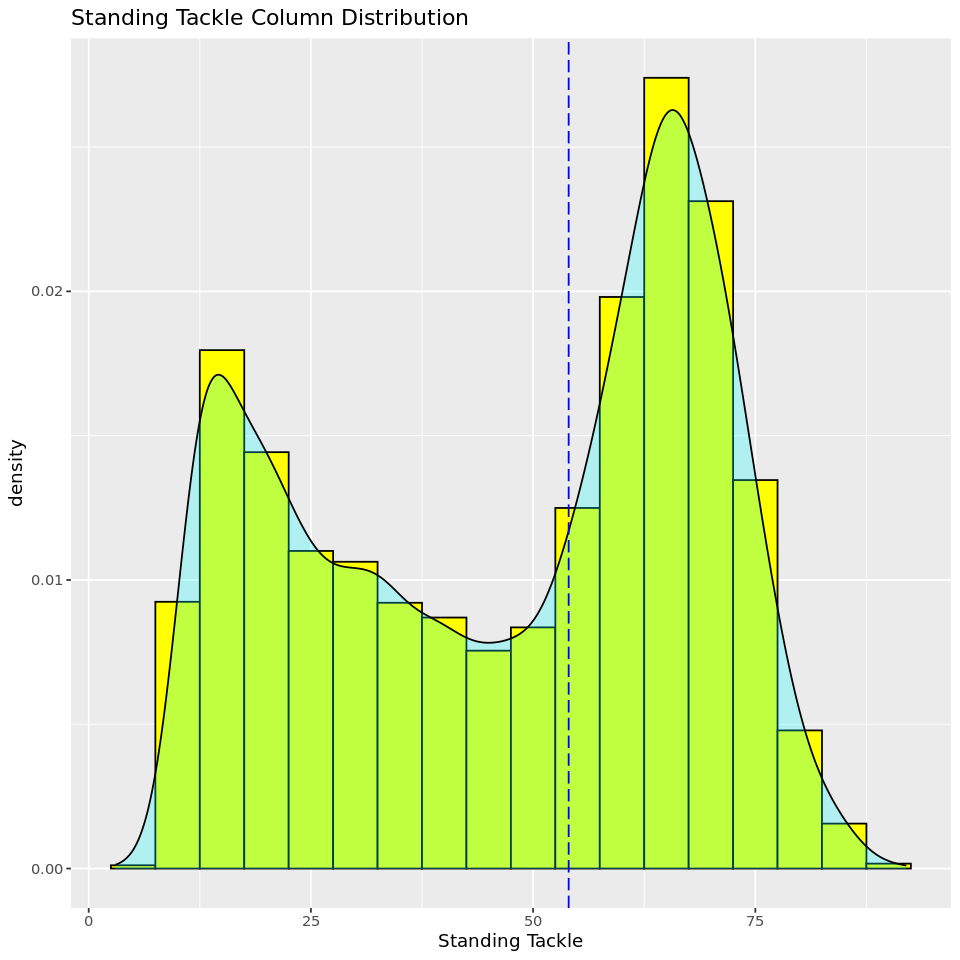

In [0]:
%r
# Distribution of Standing Tackle Position Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Standing_Tackle)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Standing_Tackle), linetype = "longdash", colour = "blue") +
  labs(
    x = "Standing Tackle",
    y = "density",
    title = "Standing Tackle Column Distribution"
  )
p1

#No issues, We almost have the same equally distributed values as well.

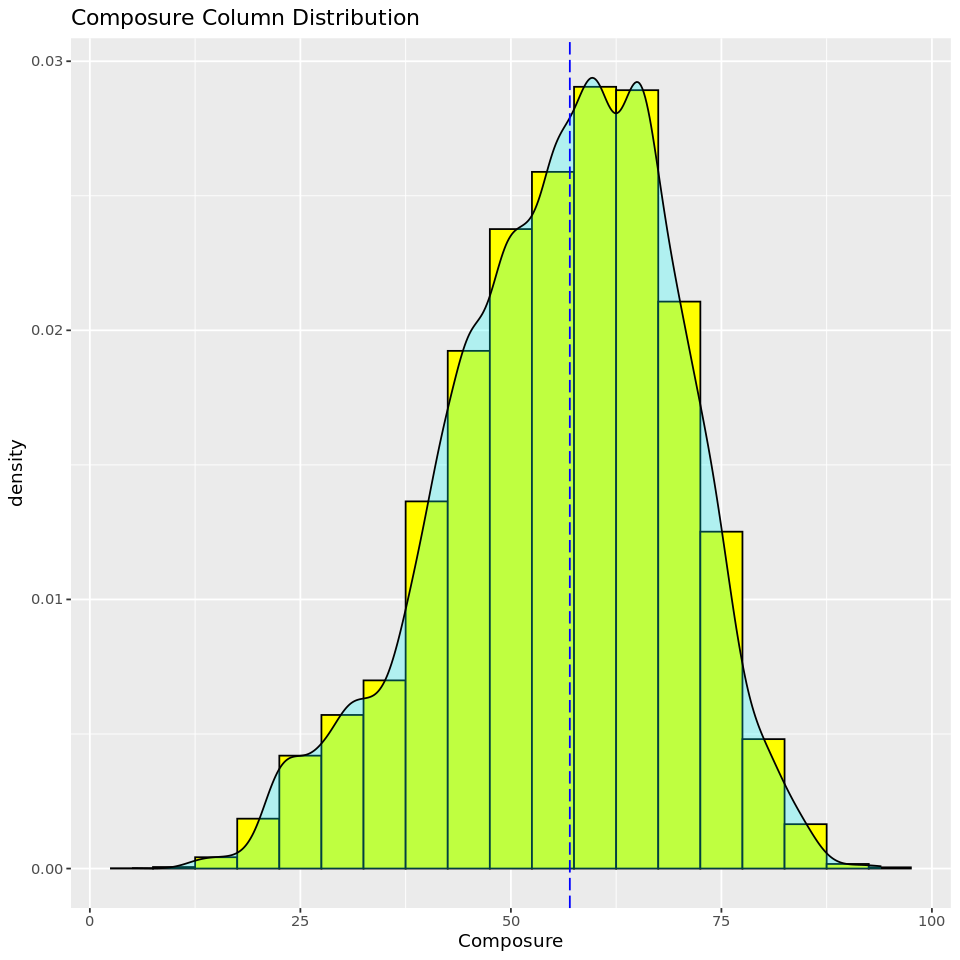

In [0]:
%r
# Distribution of Composure Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Composure)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Composure), linetype = "longdash", colour = "blue") +
  labs(
    x = "Composure",
    y = "density",
    title = "Composure Column Distribution"
  )
p1

#This column is also not skewed, The distribution makes sense. There is equal distribution here as well.

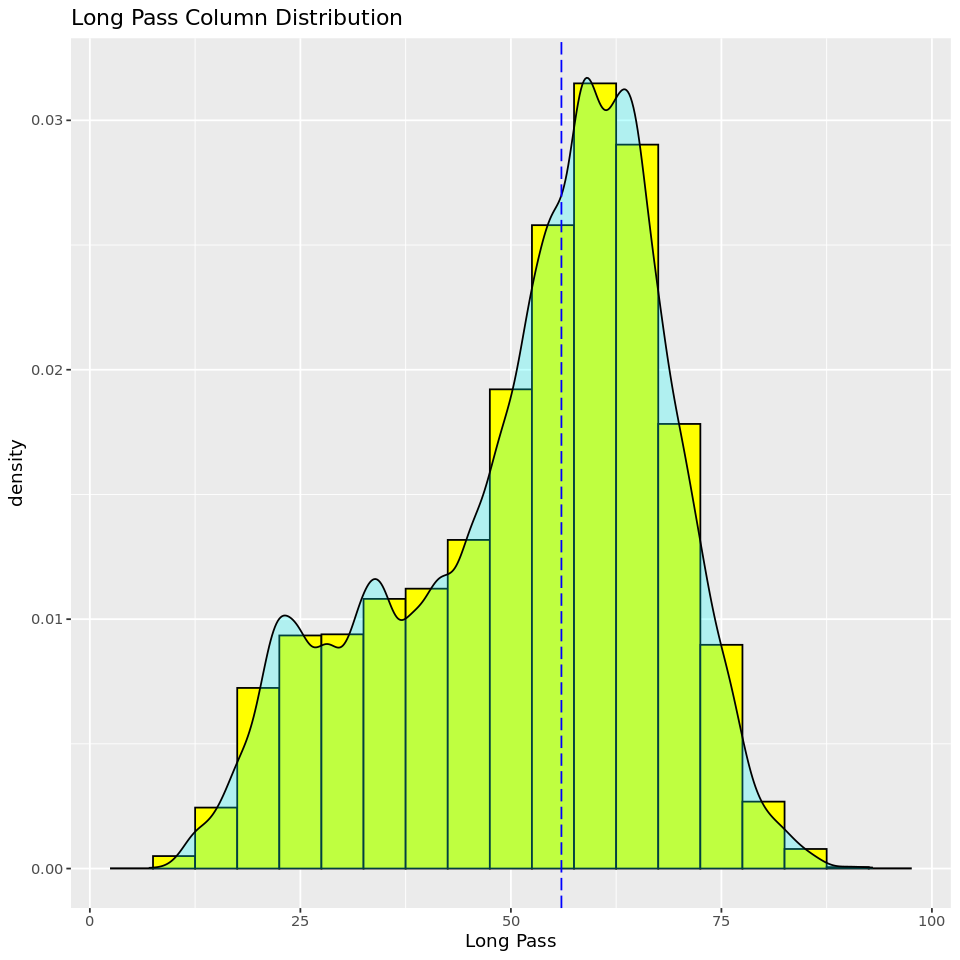

In [0]:
%r
# Distribution of Long Pass Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Long_Pass)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.6, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Long_Pass), linetype = "longdash", colour = "blue") +
  labs(
    x = "Long Pass",
    y = "density",
    title = "Long Pass Column Distribution"
  )
p1

#The diagram looks a bit skewed but it is acceptable

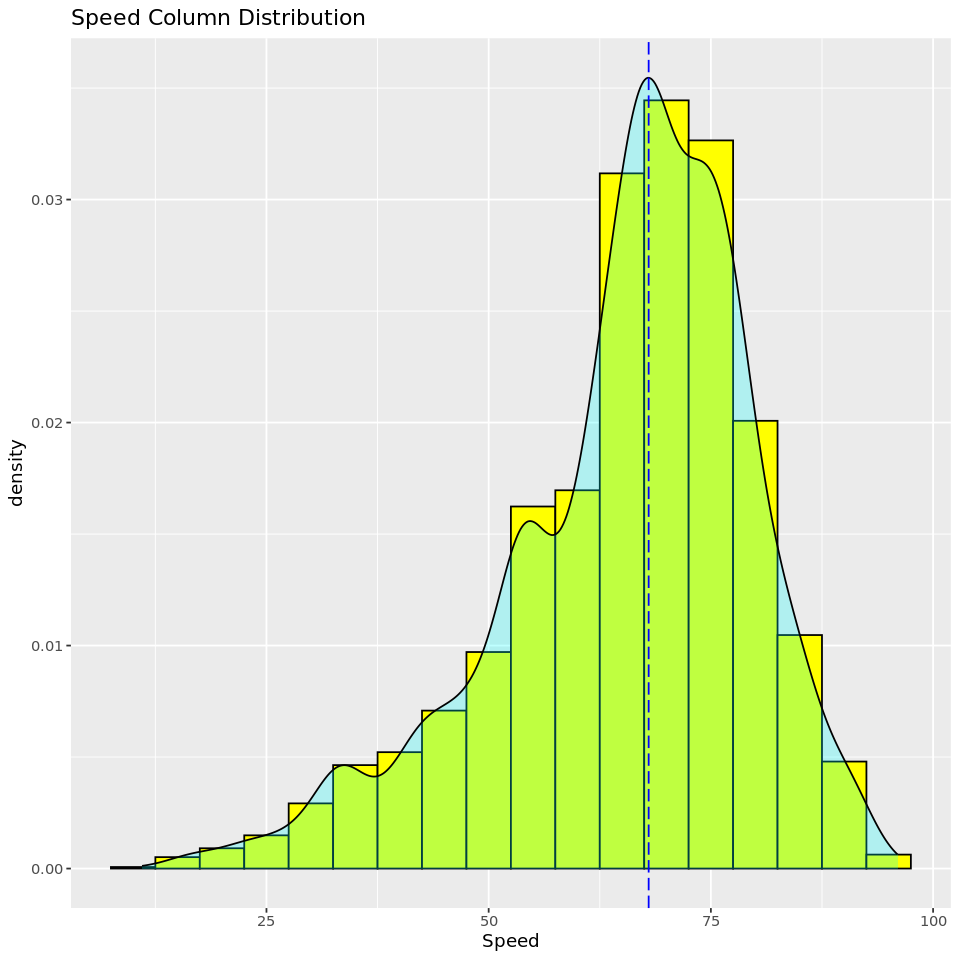

In [0]:
%r
# Distribution of Speed Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Speed)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 1.5, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Speed), linetype = "longdash", colour = "blue") +
  labs(
    x = "Speed",
    y = "density",
    title = "Speed Column Distribution"
  )
p1

#We can find a little bit of skewness, but there is no too much of it and it is acceptable

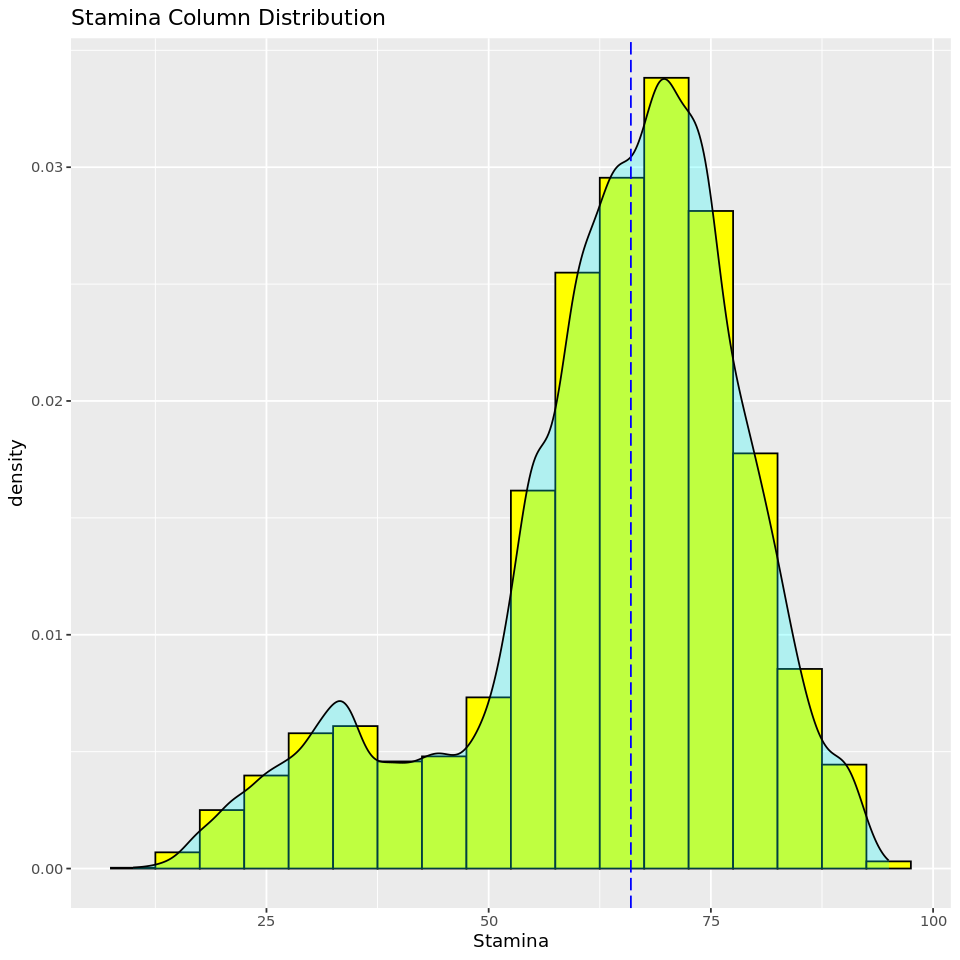

In [0]:
%r
# Distribution of Stamina Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Stamina)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.9, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Stamina), linetype = "longdash", colour = "blue") +
  labs(
    x = "Stamina",
    y = "density",
    title = "Stamina Column Distribution"
  )
p1

#There are certain values which play a major factor here but, It is of not more skewness and can be acceptable.

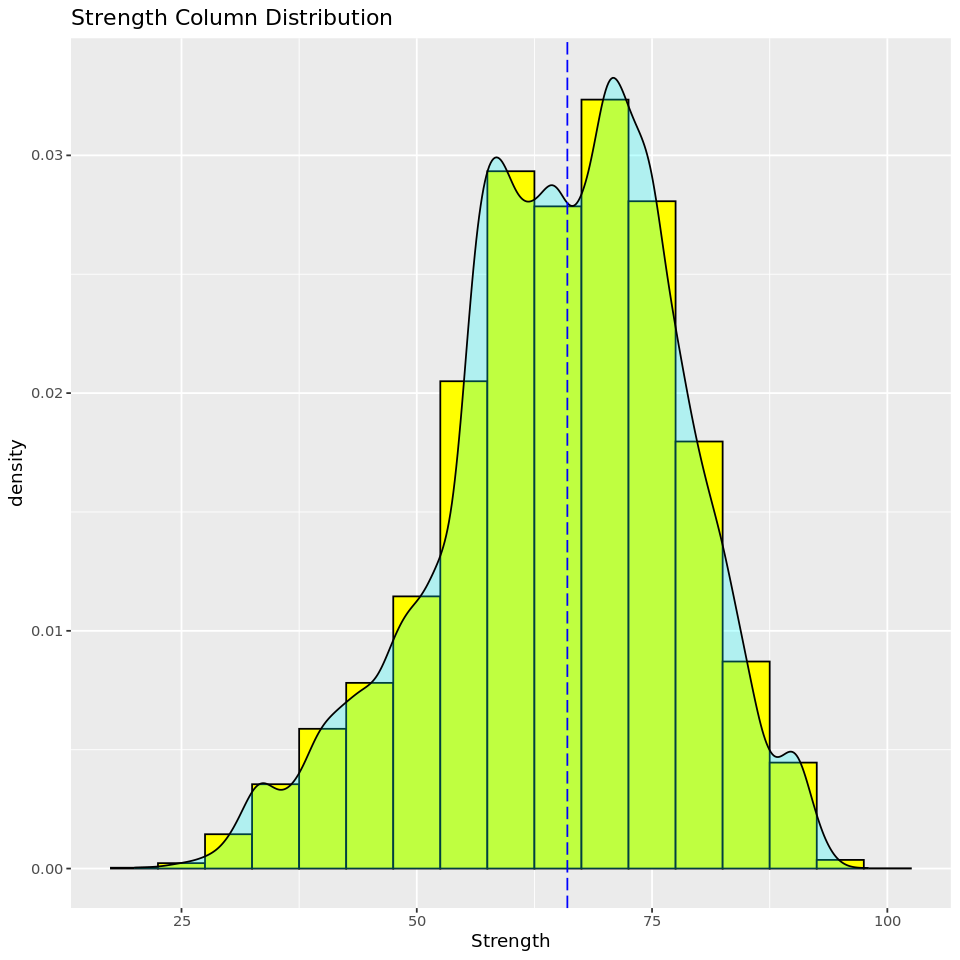

In [0]:
%r
# Distribution of Strength Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Strength)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.8, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Strength), linetype = "longdash", colour = "blue") +
  labs(
    x = "Strength",
    y = "density",
    title = "Strength Column Distribution"
  )
p1

#Not much of changes, We almost have a equal distribution over here as well

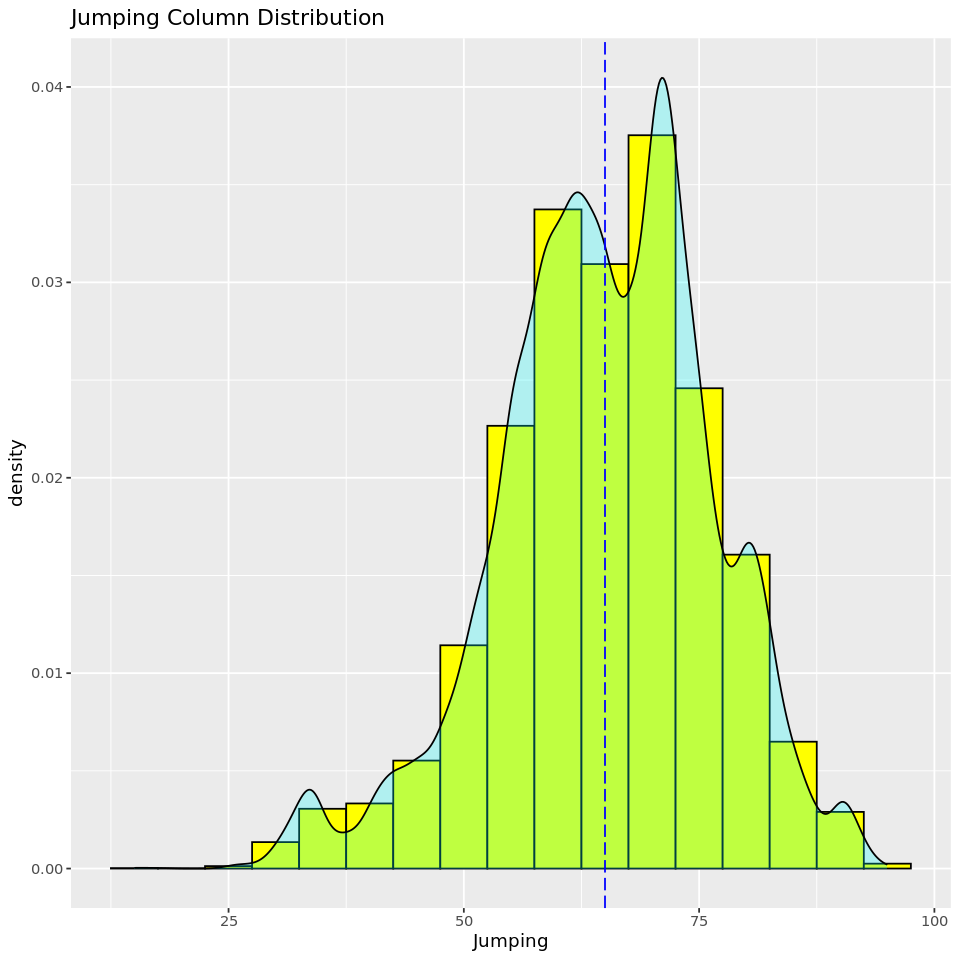

In [0]:
%r
# Distribution of Jumping Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Jumping)) + 
  geom_histogram(aes(y = ..density..), binwidth = 5, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 0.8, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Jumping), linetype = "longdash", colour = "blue") +
  labs(
    x = "Jumping",
    y = "density",
    title = "Jumping Column Distribution"
  )
p1

#No Skewness over here as well

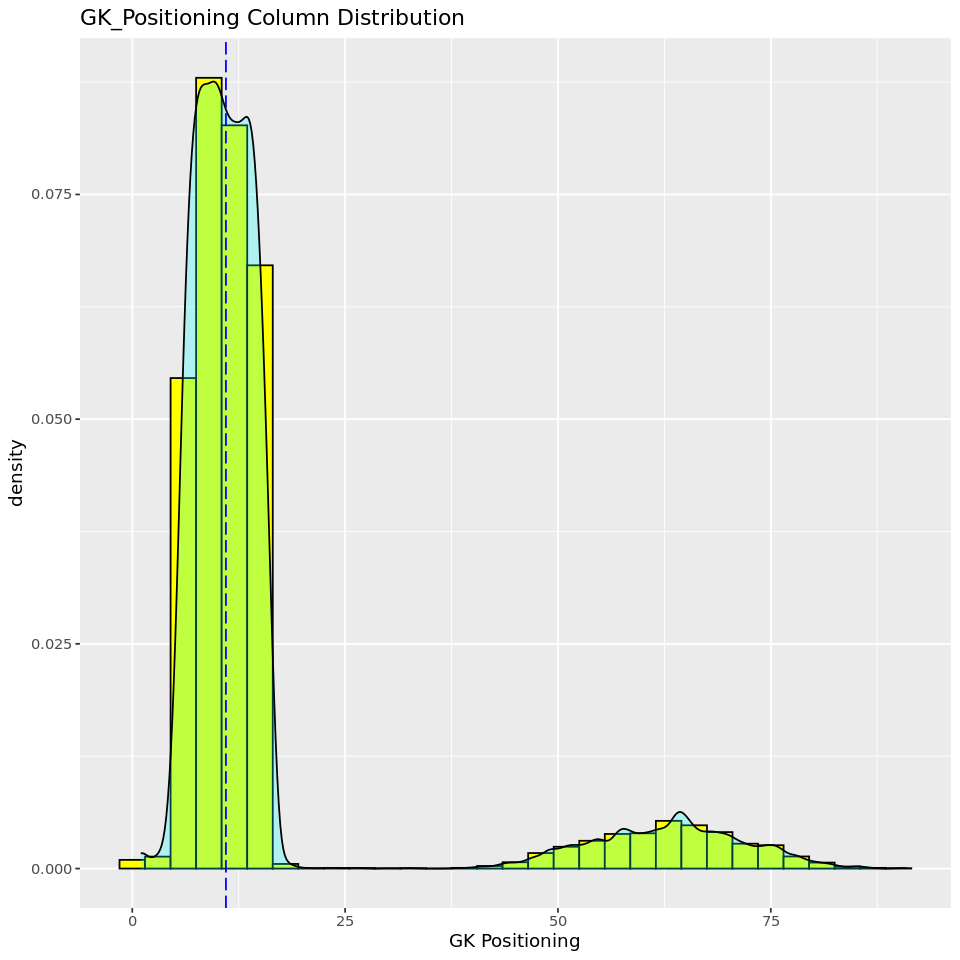

In [0]:
%r
# Distribution of GK Positioning Column

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = GK_Positioning)) + 
  geom_histogram(aes(y = ..density..), binwidth = 3, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 1.3, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$GK_Positioning), linetype = "longdash", colour = "blue") +
  labs(
    x = "GK Positioning",
    y = "density",
    title = "GK_Positioning Column Distribution"
  )
p1

#Now, We can find heavy skewness here. The histogram seems one sided with certain values occuring arround the 50,75 range. This probably has to be scaled/removed.

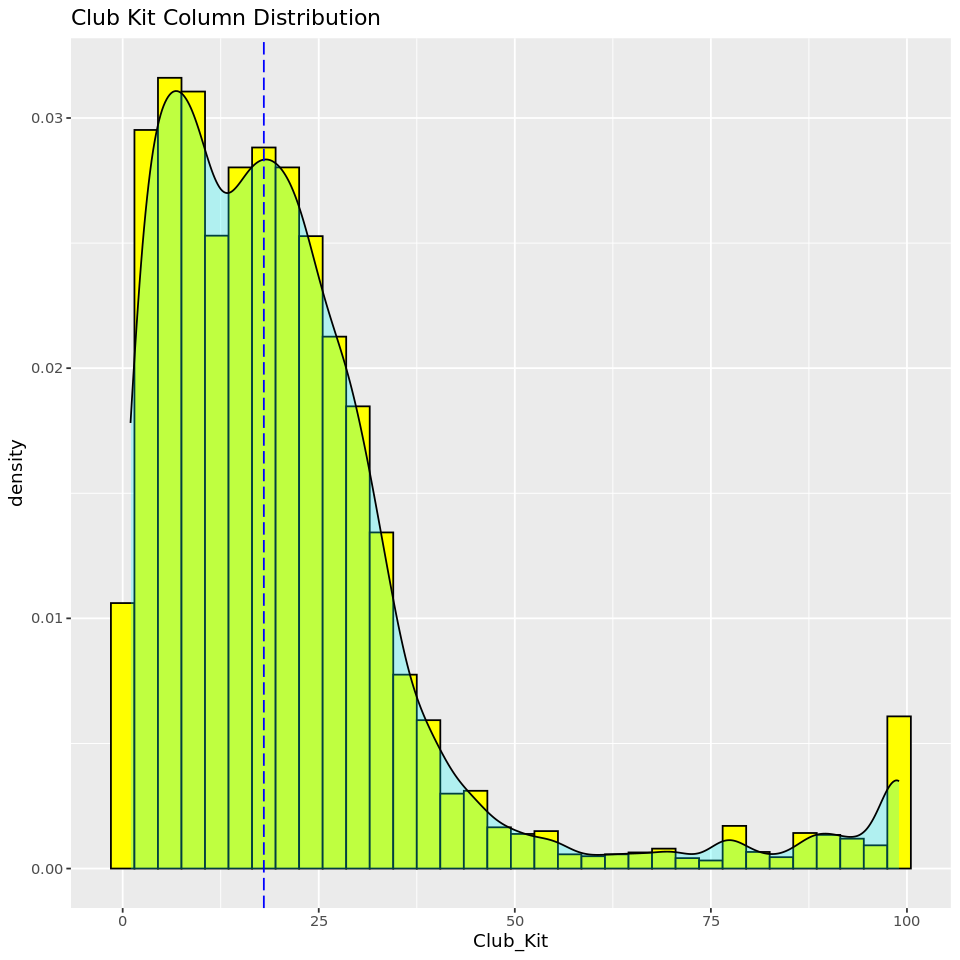

In [0]:
%r
#Distribution of Independent variable - Club_Kit

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Club_Kit)) + 
  geom_histogram(aes(y = ..density..), binwidth = 3, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 1.3, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Club_Kit), linetype = "longdash", colour = "blue") +
  labs(
    x = "Club_Kit",
    y = "density",
    title = "Club Kit Column Distribution"
  )
p1

#It is skewed to one end. This column might not be required and might be removed in the later part

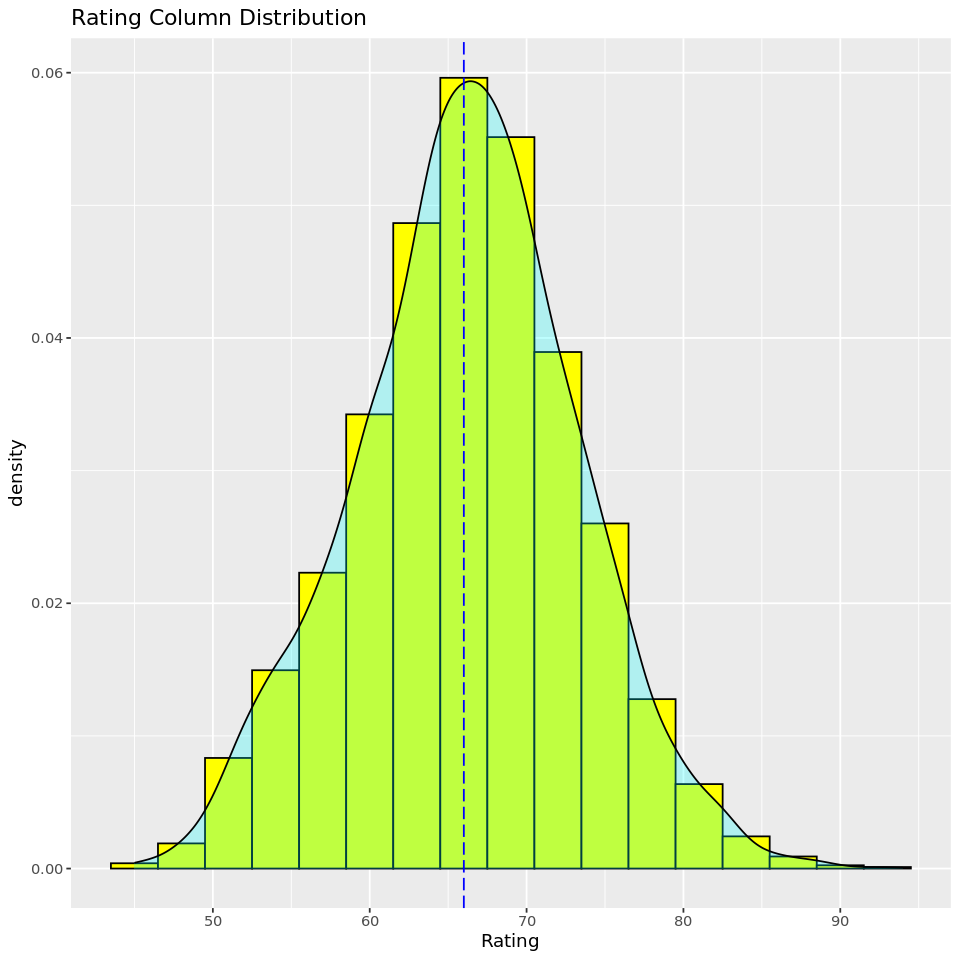

In [0]:
%r
#Distribution of Dependent variable - Rating

palette_ro <- c("yellow", "#FC4E07")
p1 <- ggplot(dataset_removedCorr, aes(x = Rating)) + 
  geom_histogram(aes(y = ..density..), binwidth = 3, fill = palette_ro[1], color = "black") +
  geom_density(adjust = 1.3, fill = "cyan", color = "black", alpha = 0.25) + 
  geom_vline(xintercept = median(dataset_removedCorr$Rating), linetype = "longdash", colour = "blue") +
  labs(
    x = "Rating",
    y = "density",
    title = "Rating Column Distribution"
  )
p1
#There is no skewness over here as well. It is very well equally distributed

In [0]:
%r
#Skewness Check
dataset_numericalValues = dataset_removedCorr[,-c(6,8,9)]
str(dataset_numericalValues)

'data.frame':	17591 obs. of  15 variables:
 $ Club_Kit          : int  29 28 41 25 7 19 8 1 4 26 ...
 $ Club_Joining      : int  2014 2014 2015 2014 2017 2016 2015 2014 2016 2015 ...
 $ Contract_Expiry   : int  2023 2018 2023 2018 2017 2019 2017 2019 2019 2020 ...
 $ Rating            : int  64 64 64 64 66 64 64 64 64 64 ...
 $ Height            : int  182 175 180 184 171 192 175 188 185 185 ...
 $ Age               : int  21 21 18 20 24 22 22 21 27 21 ...
 $ Standing_Tackle   : int  64 45 64 61 73 15 48 16 62 17 ...
 $ Attacking_Position: int  45 58 41 55 51 65 60 7 32 58 ...
 $ Composure         : int  45 61 49 52 68 49 59 32 59 50 ...
 $ Long_Pass         : int  47 59 55 61 53 33 63 21 55 36 ...
 $ Speed             : int  73 72 67 78 78 73 64 43 71 64 ...
 $ Stamina           : int  78 52 69 66 86 56 62 26 75 60 ...
 $ Strength          : int  57 47 68 61 67 75 30 53 71 64 ...
 $ Jumping           : int  71 57 77 71 79 46 66 50 58 62 ...
 $ GK_Positioning    : int  10 7 7 16 12 7 8

In [0]:
%r
install.packages("moments")
library(moments)
skewness_df = data.frame(Variable_Name = character(), skewness = numeric(), stringsAsFactors =
                           FALSE)
for(i in names(dataset_numericalValues)){
  if(is.numeric(dataset_numericalValues[[i]])){
    value = skewness(dataset_numericalValues[[i]], na.rm=TRUE)
    skewness_df = rbind(skewness_df, data.frame(Variable_Name = i, skewness = value,
                                                stringsAsFactors = FALSE))
  }
  
}
skewness_df

* installing *source* package ‘moments’ ...
** package ‘moments’ successfully unpacked and MD5 sums checked
** using staged installation
** R
** byte-compile and prepare package for lazy loading
** help
*** installing help indices
** building package indices
** testing if installed package can be loaded from temporary location
** testing if installed package can be loaded from final location
** testing if installed package keeps a record of temporary installation path
* DONE (moments)
Installing package into ‘/local_disk0/.ephemeral_nfs/envs/rEnv-0ccb5ba9-3870-455f-a50d-105d1a3d91d5’
(as ‘lib’ is unspecified)
trying URL 'https://cloud.r-project.org/src/contrib/moments_0.14.1.tar.gz'
Content type 'application/x-gzip' length 7640 bytes
downloaded 7640 bytes


The downloaded source packages are in
	‘/tmp/RtmpdpQZ5F/downloaded_packages’

Attaching package: ‘moments’

The following objects are masked from ‘package:SparkR’:

    kurtosis, skewness

        Variable_Name    skewness
1        

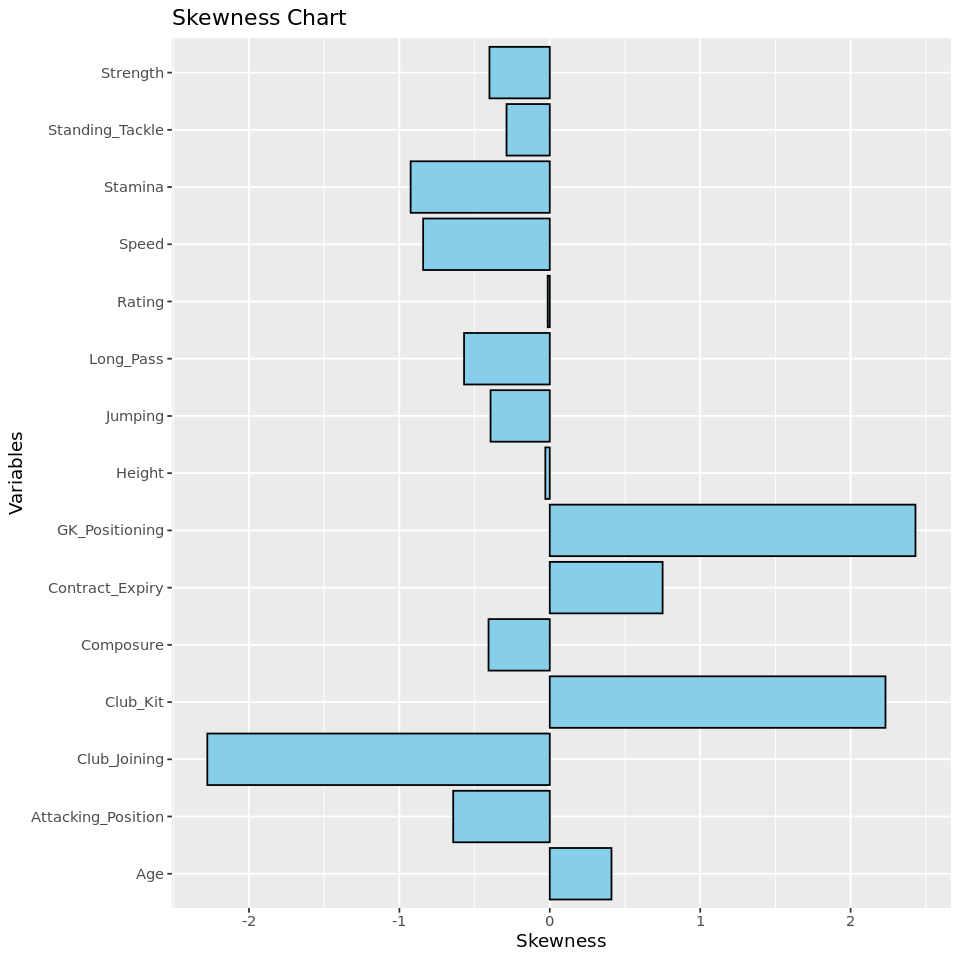

In [0]:
%r
#Creating a bar chart with all the skewness to have a good visual view
ggplot(skewness_df, aes(x = skewness, y = Variable_Name)) +
  geom_bar(stat = "identity", fill = "skyblue", color = 'black') +  # You can customize the fill color
  labs(
    title = "Skewness Chart",
    x = "Skewness",
    y = "Variables"
  )

  #As expected we can find high skewness for certain variables.
  #Positive Skewness - GK_Positioning, Club Kit
  #Negative Skewness - Club_Joining has high Negative Skewness

In [0]:
%r
#Linear Model to check which variables are important variables which play a vital role for the prediction of Rating (Checking linearity relationship)
model <- lm(Rating ~ ., data = dataset_removedCorr)
summary(model)

#We can see mostly all of the variables have heavy correlation with the dependant variable and so all the variables are impportant.


Call:
lm(formula = Rating ~ ., data = dataset_removedCorr)

Residuals:
     Min       1Q   Median       3Q      Max 
-19.1183  -2.5835  -0.0856   2.5661  15.3746 

Coefficients:
                      Estimate Std. Error t value Pr(>|t|)    
(Intercept)         -1.612e+02  4.500e+01  -3.582 0.000342 ***
Club_Kit            -7.496e-03  1.589e-03  -4.716 2.42e-06 ***
Club_Joining        -1.350e-01  1.428e-02  -9.451  < 2e-16 ***
Contract_Expiry      2.135e-01  1.769e-02  12.070  < 2e-16 ***
Height               1.127e-01  6.660e-03  16.921  < 2e-16 ***
Preferred_FootRight -2.014e-01  7.149e-02  -2.817 0.004856 ** 
Age                  1.790e-01  8.041e-03  22.258  < 2e-16 ***
Weak_foot2           6.592e-01  3.338e-01   1.975 0.048291 *  
Weak_foot3           6.420e-01  3.325e-01   1.931 0.053490 .  
Weak_foot4           1.399e+00  3.425e-01   4.085 4.44e-05 ***
Weak_foot5           1.787e+00  4.351e-01   4.107 4.02e-05 ***
Skill_Moves2        -1.985e+00  4.124e-01  -4.813 1.50e-06 ***
Sk

In [0]:
%r
class(dataset_removedCorr)

[1] "data.frame"

In [0]:
%r
#Scaling the dataset, this ensures that the variables are on the same scale and have equal influence in modeling or analysis.
scaled_fifa_df <- dataset_numericalValues 

# Columns to scale
columns_to_scale <- c("Club_Kit", "Club_Joining", "Contract_Expiry", "Rating", 
                      "Height", "Age", "Standing_Tackle", "Attacking_Position", 
                      "Composure", "Long_Pass", "Speed", "Stamina", "Strength", 
                      "Jumping", "GK_Positioning")

# Scaling specific columns in the dataset
scaled_fifa_df[, columns_to_scale] <- scale(scaled_fifa_df[, columns_to_scale])

scaled_fifa_df$Preferred_Foot = dataset_removedCorr$Preferred_Foot
scaled_fifa_df$Weak_foot = dataset_removedCorr$Weak_foot
scaled_fifa_df$Skill_Moves = dataset_removedCorr$Skill_Moves

summary(scaled_fifa_df)


    Club_Kit        Club_Joining      Contract_Expiry        Rating       
 Min.   :-1.0590   Min.   :-11.0411   Min.   :-1.11811   Min.   :-2.9869  
 1st Qu.:-0.6415   1st Qu.: -0.3168   1st Qu.:-1.11811   1st Qu.:-0.5883  
 Median :-0.1718   Median :  0.1495   Median : 0.05927   Median :-0.0239  
 Mean   : 0.0000   Mean   :  0.0000   Mean   : 0.00000   Mean   : 0.0000  
 3rd Qu.: 0.2979   3rd Qu.:  0.6158   3rd Qu.: 0.64796   3rd Qu.: 0.6816  
 Max.   : 4.0552   Max.   :  1.0821   Max.   : 2.41402   Max.   : 3.9267  
     Height              Age           Standing_Tackle   Attacking_Position
 Min.   :-3.90982   Min.   :-1.80794   Min.   :-2.0360   Min.   :-2.4522   
 1st Qu.:-0.76431   1st Qu.:-0.73947   1st Qu.:-0.9823   1st Qu.:-0.6490   
 Median :-0.01538   Median :-0.09839   Median : 0.3005   Median : 0.2268   
 Mean   : 0.00000   Mean   : 0.00000   Mean   : 0.0000   Mean   : 0.0000   
 3rd Qu.: 0.73355   3rd Qu.: 0.75639   3rd Qu.: 0.8503   3rd Qu.: 0.7420   
 Max.   : 3.87907  

In [0]:
%r
display(dataset_removedCorr)

Club_Kit,Club_Joining,Contract_Expiry,Rating,Height,Preferred_Foot,Age,Weak_foot,Skill_Moves,Standing_Tackle,Attacking_Position,Composure,Long_Pass,Speed,Stamina,Strength,Jumping,GK_Positioning
29,2014,2023,64,182,Left,21,2,2,64,45,45,47,73,78,57,71,10
28,2014,2018,64,175,Left,21,3,3,45,58,61,59,72,52,47,57,7
41,2015,2023,64,180,Right,18,3,2,64,41,49,55,67,69,68,77,7
25,2014,2018,64,184,Right,20,2,2,61,55,52,61,78,66,61,71,16
7,2017,2017,66,171,Right,24,3,2,73,51,68,53,78,86,67,79,12
19,2016,2019,64,192,Right,22,3,2,15,65,49,33,73,56,75,46,7
8,2015,2017,64,175,Left,22,3,4,48,60,59,63,64,62,30,66,8
1,2014,2019,64,188,Right,21,3,1,16,7,32,21,43,26,53,50,60
4,2016,2019,64,185,Right,27,3,2,62,32,59,55,71,75,71,58,10
26,2015,2020,64,185,Right,21,2,3,17,58,50,36,64,60,64,62,15


In [0]:
%r
#Writing to CSV file in r
write.csv(dataset_removedCorr,file='/tmp/dataset_from_r.csv',row.names = FALSE)
write.csv(scaled_fifa_df,file='/tmp/scaled_fifa_df.csv',row.names = FALSE)

In [0]:
#Copying a file to shared location - unscaled
source_location = "file:/tmp/dataset_from_r.csv"

# Destination location within Databricks
destination_location = "dbfs:/FileStore/shared_uploads/jrayen@gmu.edu/"

# Copy the file
dbutils.fs.cp(source_location, destination_location)

True

In [0]:
#Copying a file to shared location - scaled
source_location = "file:/tmp/scaled_fifa_df.csv"

# Destination location within Databricks
destination_location = "dbfs:/FileStore/shared_uploads/jrayen@gmu.edu/"

# Copy the file
dbutils.fs.cp(source_location, destination_location)

True

In [0]:
#Loading the file inro Python for Predictive Analytics
unscaled_dataset = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/jrayen@gmu.edu/dataset_from_r.csv")
scaled_dataset = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/jrayen@gmu.edu/scaled_fifa_df.csv")

In [0]:
#Checking the number of records and columns - Unscaled Dataset
num_rows = unscaled_dataset.count()
num_cols = len(unscaled_dataset.columns)

print("Number of Rows: {}".format(num_rows))
print("Number of Columns: {}".format(num_cols))

Number of Rows: 17591
Number of Columns: 18


In [0]:
#Checking the number of records and columns - Scaled Dataset
num_rows = scaled_dataset.count()
num_cols = len(scaled_dataset.columns)

print("Number of Rows: {}".format(num_rows))
print("Number of Columns: {}".format(num_cols))

Number of Rows: 17591
Number of Columns: 18


In [0]:
#Checking the records
display(unscaled_dataset)

Club_Kit,Club_Joining,Contract_Expiry,Rating,Height,Preferred_Foot,Age,Weak_foot,Skill_Moves,Standing_Tackle,Attacking_Position,Composure,Long_Pass,Speed,Stamina,Strength,Jumping,GK_Positioning
29,2014,2023,64,182,Left,21,2,2,64,45,45,47,73,78,57,71,10
28,2014,2018,64,175,Left,21,3,3,45,58,61,59,72,52,47,57,7
41,2015,2023,64,180,Right,18,3,2,64,41,49,55,67,69,68,77,7
25,2014,2018,64,184,Right,20,2,2,61,55,52,61,78,66,61,71,16
7,2017,2017,66,171,Right,24,3,2,73,51,68,53,78,86,67,79,12
19,2016,2019,64,192,Right,22,3,2,15,65,49,33,73,56,75,46,7
8,2015,2017,64,175,Left,22,3,4,48,60,59,63,64,62,30,66,8
1,2014,2019,64,188,Right,21,3,1,16,7,32,21,43,26,53,50,60
4,2016,2019,64,185,Right,27,3,2,62,32,59,55,71,75,71,58,10
26,2015,2020,64,185,Right,21,2,3,17,58,50,36,64,60,64,62,15


In [0]:
#Checking the data types
unscaled_dataset.printSchema()

root
 |-- Club_Kit: string (nullable = true)
 |-- Club_Joining: string (nullable = true)
 |-- Contract_Expiry: string (nullable = true)
 |-- Rating: string (nullable = true)
 |-- Height: string (nullable = true)
 |-- Preferred_Foot: string (nullable = true)
 |-- Age: string (nullable = true)
 |-- Weak_foot: string (nullable = true)
 |-- Skill_Moves: string (nullable = true)
 |-- Standing_Tackle: string (nullable = true)
 |-- Attacking_Position: string (nullable = true)
 |-- Composure: string (nullable = true)
 |-- Long_Pass: string (nullable = true)
 |-- Speed: string (nullable = true)
 |-- Stamina: string (nullable = true)
 |-- Strength: string (nullable = true)
 |-- Jumping: string (nullable = true)
 |-- GK_Positioning: string (nullable = true)



In [0]:
#Converting string variables to integers
variables = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Rating', 'Height', 'Age', 'Standing_Tackle', 'Composure', 'Long_Pass','Speed','Contract_Expiry','Stamina', 'Strength', 'Jumping','GK_Positioning', 'Attacking_Position']


for variable in variables:
    unscaled_dataset = unscaled_dataset.withColumn(variable, unscaled_dataset[variable].cast('double'))

In [0]:
#Checking the data types after transformation
unscaled_dataset.printSchema()

root
 |-- Club_Kit: double (nullable = true)
 |-- Club_Joining: double (nullable = true)
 |-- Contract_Expiry: double (nullable = true)
 |-- Rating: double (nullable = true)
 |-- Height: double (nullable = true)
 |-- Preferred_Foot: string (nullable = true)
 |-- Age: double (nullable = true)
 |-- Weak_foot: string (nullable = true)
 |-- Skill_Moves: string (nullable = true)
 |-- Standing_Tackle: double (nullable = true)
 |-- Attacking_Position: double (nullable = true)
 |-- Composure: double (nullable = true)
 |-- Long_Pass: double (nullable = true)
 |-- Speed: double (nullable = true)
 |-- Stamina: double (nullable = true)
 |-- Strength: double (nullable = true)
 |-- Jumping: double (nullable = true)
 |-- GK_Positioning: double (nullable = true)



In [0]:
dbutils.data.summarize(unscaled_dataset)

<!DOCTYPE html>

In [0]:
#Checking datatype pf scaled dataset
scaled_dataset.printSchema()

root
 |-- Club_Kit: string (nullable = true)
 |-- Club_Joining: string (nullable = true)
 |-- Contract_Expiry: string (nullable = true)
 |-- Rating: string (nullable = true)
 |-- Height: string (nullable = true)
 |-- Age: string (nullable = true)
 |-- Standing_Tackle: string (nullable = true)
 |-- Attacking_Position: string (nullable = true)
 |-- Composure: string (nullable = true)
 |-- Long_Pass: string (nullable = true)
 |-- Speed: string (nullable = true)
 |-- Stamina: string (nullable = true)
 |-- Strength: string (nullable = true)
 |-- Jumping: string (nullable = true)
 |-- GK_Positioning: string (nullable = true)
 |-- Preferred_Foot: string (nullable = true)
 |-- Weak_foot: string (nullable = true)
 |-- Skill_Moves: string (nullable = true)



In [0]:
#Converting string variables to integers
variables = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Rating', 'Height', 'Age', 'Standing_Tackle', 'Composure', 'Long_Pass','Speed','Contract_Expiry','Stamina', 'Strength', 'Jumping','GK_Positioning', 'Attacking_Position']


for variable in variables:
    scaled_dataset = scaled_dataset.withColumn(variable, scaled_dataset[variable].cast('double'))

In [0]:
display(scaled_dataset)

Club_Kit,Club_Joining,Contract_Expiry,Rating,Height,Age,Standing_Tackle,Attacking_Position,Composure,Long_Pass,Speed,Stamina,Strength,Jumping,GK_Positioning,Preferred_Foot,Weak_foot,Skill_Moves
0.402227315562381,-0.31675227475177,2.41402481318984,-0.306089771280227,0.13440827713375,-0.953161119391981,0.758697417418438,-0.23685086489775,-0.804836475056695,-0.345805665165388,0.532761357303865,0.938276266391742,-0.645062942157858,0.53215723047349,-0.385622650250651,Left,2,2
0.350041359195421,-0.31675227475177,-0.529422229772818,-0.306089771280227,-0.914095493624477,-0.953161119391981,-0.111791618599863,0.432904255447148,0.381089304075282,0.422460497767749,0.46184878892968,-0.741683579423879,-1.44306726123145,-0.6927270143756,-0.560665348699624,Left,3,3
1.02845879196589,0.14952297756279,2.41402481318984,-0.306089771280227,-0.165164228797172,-1.59424254316717,0.758697417418438,-0.442929363465412,-0.508355030273701,0.166371776790037,0.107285947058755,0.356751704378642,0.232741808823096,1.0571076211231,-0.560665348699624,Right,3,2
0.193483490094543,-0.31675227475177,-0.529422229772818,-0.306089771280227,0.433980783064672,-1.16685492731704,0.62125178015239,0.278345381521402,-0.285993946686455,0.550504858256605,0.887324199174791,0.162910183707609,-0.32586121452842,0.53215723047349,-0.0355372533527049,Right,2,2
-0.745863724510729,1.08207348219191,-1.11811163836535,-0.0239019841312052,-1.51324050548632,-0.312079695616787,1.17103432921658,0.0722668829537412,0.899931832445522,0.0383274163011806,0.887324199174791,1.45518698818116,0.152941376915736,1.23209108467297,-0.268927517951336,Right,3,2
-0.119632248107215,0.615798229877351,0.0592671788197136,-0.306089771280227,1.63227080678836,-0.739467311466916,-1.48624799126034,0.793541627940555,-0.508355030273701,-1.24211618858738,0.532761357303865,-0.483228218529168,0.791344832174612,-1.65513606389988,-0.560665348699624,Right,3,2
-0.693677768143769,0.14952297756279,-1.11811163836535,-0.306089771280227,-0.914095493624477,-0.739467311466916,0.0256540186661847,0.535943504730979,0.232848581683784,0.678549218745461,-0.1054517580638,-0.0955451771871016,-2.79967460365656,0.094698571598815,-0.502317782549966,Left,3,4
-1.05897946271249,-0.31675227475177,0.0592671788197136,-0.306089771280227,1.03312579492652,-0.953161119391981,-1.44043277883832,-2.19459660129053,-1.76840117060143,-2.01038235152052,-1.59461569392169,-2.4216434252395,-0.964264669787296,-1.30516913680014,2.53175565723223,Right,3,1
-0.902421593611607,0.615798229877351,0.0592671788197136,-0.306089771280227,0.583767036030133,0.329001728158406,0.667066992574406,-0.906605985242649,0.232848581683784,0.166371776790037,0.390936220555495,0.744434745720709,0.472143104545174,-0.605235282600665,-0.385622650250651,Right,3,2
0.245669446461502,0.14952297756279,0.647956587412245,-0.306089771280227,0.583767036030133,-0.953161119391981,-1.39461756641631,0.432904255447148,-0.434234669077953,-1.0500496478541,-0.1054517580638,-0.224772857634457,-0.0864599188063421,-0.255268355500925,-0.0938848195023626,Right,2,3


In [0]:
dbutils.data.summarize(scaled_dataset)

<!DOCTYPE html>

In [0]:
# Split the unscaled dataset into training and test sets (80% train, 20% test)

train_df, test_df = unscaled_dataset.randomSplit([0.8, 0.2], seed=42)

# Showing the shapes of the resulting DataFrames
print(f"Number of records in unscaled Training Set: {train_df.count()} rows")
print(f"Number of records in unscaled Testing Set: {test_df.count()} rows")

print(type(train_df))

Number of records in unscaled Training Set: 14124 rows
Number of records in unscaled Testing Set: 3467 rows
<class 'pyspark.sql.dataframe.DataFrame'>


In [0]:
# Split the scaled dataset into training and test sets (80% train, 20% test)

train_df1, test_df1 = scaled_dataset.randomSplit([0.8, 0.2], seed=42)

# Showing the shapes of the resulting DataFrames
print(f"Number of records in scaled Training Set: {train_df1.count()} rows")
print(f"Number of records in scaled Testing Set: {test_df1.count()} rows")


Number of records in scaled Training Set: 14157 rows
Number of records in scaled Testing Set: 3434 rows


#Model-1: MULTIPLE LINEAR REGRESSION (Un-scaled)

In [0]:
#Model-1: MULTIPLE LINEAR REGRESSION (Un-scaled)

from pyspark.ml.feature import StringIndexer, VectorAssembler
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator

# Categorical columns
categorical_cols = ['Preferred_Foot', 'Weak_foot', 'Skill_Moves']

# StringIndexer for categorical columns
indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_index").fit(train_df) for col in categorical_cols]

# Applying the indexers to transform categorical columns
for indexer in indexers:
    train_df = indexer.transform(train_df)
    test_df = indexer.transform(test_df)

# Features and target variable
features = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Height', 'Age',
            'Standing_Tackle', 'Attacking_Position', 'Composure', 'Long_Pass',
            'Speed', 'Stamina', 'Strength', 'Jumping', 'GK_Positioning',
            'Preferred_Foot_index', 'Weak_foot_index', 'Skill_Moves_index']

target = 'Rating'

# VectorAssembler to combine features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol="assembled_features3")

# Transforming the data
train_df = assembler.transform(train_df)
test_df = assembler.transform(test_df)

# Train a Linear Regression model
lr = LinearRegression(featuresCol='assembled_features3', labelCol=target)
lr_model = lr.fit(train_df)

# Make predictions on the test set
predictions = lr_model.transform(test_df)

# Show predicted values and actual values
predictions.select("prediction", target).show()

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse_1 = evaluator_rmse.evaluate(predictions)
print(f"Root Mean Squared Error (RMSE) for Multiple Linear Regression: {rmse_1}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae_1 = evaluator_mae.evaluate(predictions)
print(f"Mean Absolute Error (MAE): {mae_1}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2_1 = evaluator_r2.evaluate(predictions)
print(f"R-squared: {r2_1}")

+-----------------+------+
|       prediction|Rating|
+-----------------+------+
|70.48424707402503|  66.0|
|76.66678096556771|  77.0|
|64.46275919823765|  62.0|
|66.61198824852514|  71.0|
| 69.9373532358745|  71.0|
| 67.7105159223353|  66.0|
|73.58573381052773|  70.0|
|60.63970657794775|  58.0|
|77.83948784909384|  79.0|
|67.32677196086681|  58.0|
|70.37546172367499|  68.0|
|74.39133174930677|  81.0|
|68.46363318265836|  75.0|
|71.02455791168026|  70.0|
|  66.853909293812|  68.0|
|80.23269099952162|  77.0|
|62.10735342008306|  70.0|
|60.74629331361976|  71.0|
|67.70277739156293|  66.0|
|71.76749341457722|  83.0|
+-----------------+------+
only showing top 20 rows

Root Mean Squared Error (RMSE) for Multiple Linear Regression: 3.885026924578347
Mean Absolute Error (MAE): 3.0853436650595336
R-squared: 0.6946701528687056


#Model-2: MULTIPLE LINEAR REGRESSION (scaled)

In [0]:
#Model-2: MULTIPLE LINEAR REGRESSION (scaled)

from pyspark.ml.feature import StringIndexer, VectorAssembler
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml import Pipeline

# Categorical columns
categorical_cols = ['Preferred_Foot', 'Weak_foot', 'Skill_Moves']

# StringIndexer for categorical columns
indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_index").fit(train_df1) for col in categorical_cols]

# Applying the indexers to transform categorical columns
for indexer in indexers:
    train_df1 = indexer.transform(train_df1)
    test_df1 = indexer.transform(test_df1)

# Features and target variable
features = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Height', 'Age',
            'Standing_Tackle', 'Attacking_Position', 'Composure', 'Long_Pass',
            'Speed', 'Stamina', 'Strength', 'Jumping', 'GK_Positioning',
            'Preferred_Foot_index', 'Weak_foot_index', 'Skill_Moves_index']

target = 'Rating'

# VectorAssembler to combine features into a single vector column
assembler1 = VectorAssembler(inputCols=features, outputCol="assembled_features4")

# Transform the data
train_df1 = assembler1.transform(train_df1)
test_df1 = assembler1.transform(test_df1)

# Train a Linear Regression model
lr1 = LinearRegression(featuresCol='assembled_features4', labelCol=target)
lr_model1 = lr1.fit(train_df1)

# Make predictions on the test set
predictions1 = lr_model1.transform(test_df1)

# Show predicted values and actual values
predictions1.select("prediction", target).show()

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse_2 = evaluator_rmse.evaluate(predictions)
print(f"Root Mean Squared Error (RMSE) for Multiple Linear Regression - scaled: {rmse_2}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae_2 = evaluator_mae.evaluate(predictions)
print(f"Mean Absolute Error (MAE): {mae_2}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2_2 = evaluator_r2.evaluate(predictions)
print(f"R-squared: {r2_2}")

+--------------------+-------------------+
|          prediction|             Rating|
+--------------------+-------------------+
|  0.5967063346726404|-0.0239019841312052|
|  0.4957309759367706| -0.164995877705716|
|  0.5175618207055472|  0.540473590166838|
|-0.11423716563312206|  0.117191909443306|
|  0.5946813002885982|  0.681567483741349|
|   1.035609094288531|  0.540473590166838|
| -0.1344444046205089|  -0.87046534557827|
| 0.15005816867784424|  -1.15265313272729|
|-0.30673330641504304|  0.399379696592327|
|-0.17677499616788275| -0.164995877705716|
| 0.09761482211532677|  0.258285803017817|
|-0.07583556029126251| -0.306089771280227|
| -0.7594460480837575|  -1.15265313272729|
|  0.6511957883491784|  0.258285803017817|
|-0.49066618819962293| -0.447183664854738|
| 0.04461212436189724|  -1.15265313272729|
|  0.4421568755947807| -0.164995877705716|
|  1.1754705259079605|   0.82266137731586|
|-0.06303876884086143|  -0.87046534557827|
|   0.984720573139843|   0.82266137731586|
+----------

#Model-3: Decision Trees Regression Algorithm (UnScaled)

In [0]:
#Model-3: Decision Trees Regression Algorithm (UnScaled)
from pyspark.ml.feature import StringIndexer, VectorAssembler
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml import Pipeline

# VectorAssembler to combine features into a single vector column
assembler3 = VectorAssembler(inputCols=features, outputCol="assembled_features5")

#Declaring the Decision Tree
dt = DecisionTreeClassifier(labelCol=target, featuresCol="assembled_features5")

# Create a pipeline
pipeline = Pipeline(stages=[assembler3, dt])

#Fitting the model on the training data
model = pipeline.fit(train_df)

#Making Predictions
predictions3 = model.transform(test_df)

#Displaying Results
predictions3.select("prediction", target).show()

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse_3 = evaluator_rmse.evaluate(predictions3)
print(f"Root Mean Squared Error (RMSE) for Decision tree Regression algorithm: {rmse_3}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae_3 = evaluator_mae.evaluate(predictions3)
print(f"Mean Absolute Error (MAE): {mae_3}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2_3 = evaluator_r2.evaluate(predictions3)
print(f"R-squared: {r2_3}")

+----------+------+
|prediction|Rating|
+----------+------+
|      73.0|  66.0|
|      77.0|  77.0|
|      64.0|  62.0|
|      64.0|  71.0|
|      73.0|  71.0|
|      64.0|  66.0|
|      68.0|  70.0|
|      64.0|  58.0|
|      68.0|  79.0|
|      64.0|  58.0|
|      64.0|  68.0|
|      68.0|  81.0|
|      73.0|  75.0|
|      73.0|  70.0|
|      73.0|  68.0|
|      68.0|  77.0|
|      64.0|  70.0|
|      73.0|  71.0|
|      68.0|  66.0|
|      77.0|  83.0|
+----------+------+
only showing top 20 rows

Root Mean Squared Error (RMSE) for Decision tree Regression algorithm: 3.9570086565399287
Mean Absolute Error (MAE): 3.014133256417652
R-squared: 0.683251041860111


#Model - 4: Random Forest Regression Algorithm (UnScaled)

In [0]:
#Model - 4: Random Forest Regression Algorithm (UnScaled)
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml import Pipeline

# VectorAssembler to combine features into a single vector column
assembler5 = VectorAssembler(inputCols=features, outputCol="assembled_features6")

# Create a RandomForestRegressor
rf = RandomForestRegressor(labelCol=target, featuresCol="assembled_features6")

# Create a pipeline
pipeline = Pipeline(stages=[assembler5, rf])

#Fitting the model to the training set
model = pipeline.fit(train_df)

# Make predictions on the test set
predictions5 = model.transform(test_df)

#Displaying Results
predictions5.select("prediction", target).show()

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse_4 = evaluator_rmse.evaluate(predictions5)
print(f"Root Mean Squared Error (RMSE) for Random Forest Regression: {rmse_4}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae_4 = evaluator_mae.evaluate(predictions5)
print(f"Mean Absolute Error (MAE): {mae_4}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2_4 = evaluator_r2.evaluate(predictions5)
print(f"R-squared: {r2_4}")

+-----------------+------+
|       prediction|Rating|
+-----------------+------+
| 69.8687782047313|  66.0|
|69.47467722945309|  77.0|
|63.28973848995709|  62.0|
|65.82232294567672|  71.0|
|70.46084360560138|  71.0|
|65.65652341187719|  66.0|
|70.15954443549053|  70.0|
|63.39638722977759|  58.0|
|69.78655655951306|  79.0|
|63.73105543660076|  58.0|
|65.78392784536747|  68.0|
|69.78589873944426|  81.0|
| 70.0165217646065|  75.0|
|70.42783911444324|  70.0|
|70.46084360560138|  68.0|
|70.57522084415056|  77.0|
|64.59730872346685|  70.0|
|68.96838159572036|  71.0|
|67.04880428935144|  66.0|
| 69.4583827740006|  83.0|
+-----------------+------+
only showing top 20 rows

Root Mean Squared Error (RMSE) for Random Forest Regression: 3.519189387989953
Mean Absolute Error (MAE): 2.6778426452180413
R-squared: 0.7494661149482641


#Model 5 - Support Vector Machine (Kernel Model) - Non Linear Version (UnScaled)

In [0]:
#Model 5 - Support Vector Machine (Kernel Model) - Non Linear Version
from pyspark.ml.regression import GBTRegressor
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator

# VectorAssembler to combine features into a single vector column
assembler6 = VectorAssembler(inputCols=features, outputCol="assembled_features7")

# Create a GBTRegressor with the Gaussian RBF kernel for SVM regression
svm_regressor = GBTRegressor(labelCol=target, featuresCol="assembled_features7")

# Create a pipeline
pipeline = Pipeline(stages=[assembler6, svm_regressor])

# Fit the model
model = pipeline.fit(train_df)

# Make predictions on the test set
predictions6 = model.transform(test_df)

#Displaying Results
predictions6.select("prediction", target).show()

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse_5 = evaluator_rmse.evaluate(predictions6)
print(f"Root Mean Squared Error (RMSE) for Support Vector Machine (Kernel Model) - Non Linear: {rmse_5}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae_5 = evaluator_mae.evaluate(predictions6)
print(f"Mean Absolute Error (MAE): {mae_5}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2_5 = evaluator_r2.evaluate(predictions6)
print(f"R-squared: {r2_5}")

+------------------+------+
|        prediction|Rating|
+------------------+------+
| 72.52132428317609|  66.0|
| 72.48866298241514|  77.0|
|  61.0046471134783|  62.0|
| 65.24355396614068|  71.0|
| 71.09578905212588|  71.0|
|  66.1997783046311|  66.0|
| 74.18092897709529|  70.0|
|61.464130385335444|  58.0|
| 74.99918380539015|  79.0|
|  62.0800142186621|  58.0|
|  65.6533985511363|  68.0|
| 76.19328388483606|  81.0|
| 71.93024395328297|  75.0|
| 71.13484220230666|  70.0|
| 71.89809171804852|  68.0|
| 79.44051899893772|  77.0|
| 64.69531068088453|  70.0|
| 71.21944006595605|  71.0|
| 63.45776429980872|  66.0|
| 72.58778137063072|  83.0|
+------------------+------+
only showing top 20 rows

Root Mean Squared Error (RMSE) for Support Vector Machine (Kernel Model) - Non Linear: 2.8647751711179734
Mean Absolute Error (MAE): 2.2122332184557236
R-squared: 0.8339792840521782


#Model 6 - Support Vector Machine (Linear Model) -  Linear Version (UnScaled)

In [0]:
#Model 6 - Support Vector Machine (Linear Model) -  Linear Version
from pyspark.ml.regression import LinearRegression
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator

# VectorAssembler to combine features into a single vector column
assembler7 = VectorAssembler(inputCols=features, outputCol="assembled_features8")

# Create a GBTRegressor with the Gaussian RBF kernel for SVM regression
linear_svm = LinearRegression(labelCol=target, featuresCol="assembled_features8")

# Create a pipeline
pipeline = Pipeline(stages=[assembler7, linear_svm])

# Fit the model
model = pipeline.fit(train_df)

# Make predictions on the test set
predictions7 = model.transform(test_df)

#Displaying Results
predictions7.select("prediction", target).show()

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse_6 = evaluator_rmse.evaluate(predictions7)
print(f"Root Mean Squared Error (RMSE) for Support Vector Machine (Linear Model) - Linear Version: {rmse_6}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae_6 = evaluator_mae.evaluate(predictions7)
print(f"Mean Absolute Error (MAE): {mae_6}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2_6 = evaluator_r2.evaluate(predictions7)
print(f"R-squared: {r2_6}")

+-----------------+------+
|       prediction|Rating|
+-----------------+------+
|70.48424707402503|  66.0|
|76.66678096556771|  77.0|
|64.46275919823765|  62.0|
|66.61198824852514|  71.0|
| 69.9373532358745|  71.0|
| 67.7105159223353|  66.0|
|73.58573381052773|  70.0|
|60.63970657794775|  58.0|
|77.83948784909384|  79.0|
|67.32677196086681|  58.0|
|70.37546172367499|  68.0|
|74.39133174930677|  81.0|
|68.46363318265836|  75.0|
|71.02455791168026|  70.0|
|  66.853909293812|  68.0|
|80.23269099952162|  77.0|
|62.10735342008306|  70.0|
|60.74629331361976|  71.0|
|67.70277739156293|  66.0|
|71.76749341457722|  83.0|
+-----------------+------+
only showing top 20 rows

Root Mean Squared Error (RMSE) for Support Vector Machine (Linear Model) - Linear Version: 3.885026924578347
Mean Absolute Error (MAE): 3.0853436650595336
R-squared: 0.6946701528687056


#Model 7 - Applying Artificial Neural Network Algorithm using Pandas

In [0]:
#Model 7 - Applying Artificial Neural Network Algorithm using Pandas
#To apply ANN using pandas we have to convert the dataset to pandas dataframe
import numpy as np
import pandas as pd
import tensorflow as tf

#Changing spark dataframe to pandas
unscaled_dataset_pandas = unscaled_dataset.toPandas()

#Checking data types
print(unscaled_dataset_pandas.dtypes)

Club_Kit              float64
Club_Joining          float64
Contract_Expiry       float64
Rating                float64
Height                float64
Preferred_Foot         object
Age                   float64
Weak_foot              object
Skill_Moves            object
Standing_Tackle       float64
Attacking_Position    float64
Composure             float64
Long_Pass             float64
Speed                 float64
Stamina               float64
Strength              float64
Jumping               float64
GK_Positioning        float64
dtype: object


In [0]:
#Independent and dependent variable split
X = unscaled_dataset_pandas.iloc[:, list(range(3)) + list(range(4, 18))].values
Y = unscaled_dataset_pandas.iloc[:, 3].values
print(X)
print(Y)

[[29.0 2014.0 2023.0 ... 57.0 71.0 10.0]
 [28.0 2014.0 2018.0 ... 47.0 57.0 7.0]
 [41.0 2015.0 2023.0 ... 68.0 77.0 7.0]
 ...
 [3.0 2014.0 2019.0 ... 76.0 69.0 11.0]
 [11.0 2015.0 2020.0 ... 36.0 59.0 12.0]
 [8.0 2015.0 2018.0 ... 61.0 70.0 9.0]]
[64. 64. 64. ... 74. 74. 74.]


In [0]:
# Encoding categorical data
# Label Encoding the "Preferred Foot" column
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
X[:, 4] = le.fit_transform(X[:, 4])
print(X[:,4])

[0 0 1 ... 0 1 1]


In [0]:
# One Hot Encoding the Weak_Foot column and Skill_Moves column
columns_to_encode = [6, 7]
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
ct = ColumnTransformer(transformers=[('encoder', OneHotEncoder(), columns_to_encode)], remainder='passthrough')
X = np.array(ct.fit_transform(X))

In [0]:
#Train/Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 0)

In [0]:
#Feature Scaling (Important step in ANN)
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [0]:
#Starting the ANN (Starting the Network Model)

#Initializing the ANN
ann = tf.keras.models.Sequential()

# Adding the input layer and the first hidden layer
ann.add(tf.keras.layers.Dense(units=64, activation='relu'))

# Adding the second hidden layer
ann.add(tf.keras.layers.Dense(units=32, activation='relu')) 

# Adding the output layer
ann.add(tf.keras.layers.Dense(units=1, activation='linear'))

#Compiling the ANN for Regression Model
ann.compile(optimizer='adam', loss='mean_squared_error')

In [0]:
# Training the ANN on the Training set
ann.fit(X_train, Y_train, batch_size = 32, epochs = 100)

Epoch 1/100
440/440 [==============================] - 2s 2ms/step - loss: 927.9461
Epoch 2/100
440/440 [==============================] - 1s 2ms/step - loss: 25.1247
Epoch 3/100
440/440 [==============================] - 1s 2ms/step - loss: 15.7073
Epoch 4/100
440/440 [==============================] - 1s 2ms/step - loss: 11.5624
Epoch 5/100
440/440 [==============================] - 1s 3ms/step - loss: 9.4121
Epoch 6/100
440/440 [==============================] - 1s 2ms/step - loss: 8.2562
Epoch 7/100
440/440 [==============================] - 1s 2ms/step - loss: 7.5413
Epoch 8/100
440/440 [==============================] - 1s 2ms/step - loss: 7.0323
Epoch 9/100
440/440 [==============================] - 1s 2ms/step - loss: 6.7147
Epoch 10/100
440/440 [==============================] - 1s 2ms/step - loss: 6.4621
Epoch 11/100
440/440 [==============================] - 1s 2ms/step - loss: 6.2285
Epoch 12/100
156/440 [=========>....................] - ETA: 0s - loss: 5.9571

INFO:tensorflow:Assets written to: /tmp/tmptqmn95pe/model/data/model/assets


INFO:tensorflow:Assets written to: /tmp/tmptqmn95pe/model/data/model/assets


In [0]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Make predictions on the test set
predictions = ann.predict(X_test)

# Flatten predictions if needed
predictions_flat = predictions.flatten()

# Create a DataFrame with predictions and true values
result_df = pd.DataFrame({'Predicted': predictions_flat, 'Actual': Y_test})
print(result_df)


110/110 [==============================] - 0s 1ms/step
      Predicted  Actual
0     58.848312    52.0
1     66.398872    67.0
2     67.990318    70.0
3     71.441605    72.0
4     77.559639    77.0
...         ...     ...
3514  76.843788    75.0
3515  57.551834    56.0
3516  64.378265    62.0
3517  68.689888    67.0
3518  56.547115    59.0

[3519 rows x 2 columns]


In [0]:
#Evaluvation Metrics
# Evaluate the model - RMSE, MAE and R-squared
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

rmse_7 = np.sqrt(mean_squared_error(result_df['Actual'], result_df['Predicted']))
mae_7 = mean_absolute_error(result_df['Actual'], result_df['Predicted'])
r_squared_7 = r2_score(result_df['Actual'], result_df['Predicted'])

# Display the metrics
print(f'Root Mean Squared Error (RMSE) for Artificial Neural Network Algorithm: {rmse_7:.2f}')
print(f'MAE: {mae_7:.2f}')
print(f'R-squared: {r_squared_7:.2f}')

Root Mean Squared Error (RMSE) for Artificial Neural Network Algorithm: 2.44
MAE: 1.86
R-squared: 0.88


#Model 8 - Applying K-Nearest Neighbors (KNN) (UnScaled)

In [0]:
#Model 8 - Applying K-Nearest Neighbors (KNN) 

from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import pandas as pd

# Assuming 'unscaled_dataset_pandas' contains your dataset with the attributes provided

# Preprocessing categorical variables using Label Encoding or One-Hot Encoding
label_encoder = LabelEncoder()
unscaled_dataset_pandas['Preferred_Foot'] = label_encoder.fit_transform(unscaled_dataset_pandas['Preferred_Foot'])

# Initialize OneHotEncoder for categorical columns
onehot_encoder = OneHotEncoder()

# Apply OneHotEncoder to 'Weak_foot' and 'Skill_Moves' columns
encoded_columns = onehot_encoder.fit_transform(unscaled_dataset_pandas[['Weak_foot', 'Skill_Moves']])

encoded_column_names = onehot_encoder.get_feature_names(['Weak_foot', 'Skill_Moves'])

# Create a DataFrame with the encoded columns
encoded_df = pd.DataFrame(encoded_columns.toarray(), columns=encoded_column_names)

# Combine encoded features with the remaining features
features = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Height', 'Preferred_Foot', 'Age', 'Standing_Tackle',
            'Attacking_Position', 'Composure', 'Long_Pass', 'Speed', 'Stamina', 'Strength', 'Jumping', 'GK_Positioning']
X = pd.concat([encoded_df, unscaled_dataset_pandas[features]], axis=1)

# Selecting target variable
target = 'Rating'
y = unscaled_dataset_pandas[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize KNN Regressor
knn_reg = KNeighborsRegressor(n_neighbors=5)

# Train the KNN model
knn_reg.fit(X_train, y_train)

# Make predictions on the test set
predictions = knn_reg.predict(X_test)

# Calculate Root Mean Squared Error (RMSE)
rmse = mean_squared_error(y_test, predictions, squared=False)
print(f"Root Mean Squared Error (RMSE) for KNN: {rmse}")

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, predictions)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate R-squared (R²)
r_squared = r2_score(y_test, predictions)
print(f"R-squared (R²): {r_squared}")


/databricks/python/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



Root Mean Squared Error (RMSE) for KNN: 2.9387824300331125
Mean Absolute Error (MAE): 2.273884626314294
R-squared (R²): 0.8219225634939196


#Model 9 - Applying Polynomial Regression (UnScaled)

In [0]:
#Model 9 - Applying Polynomial Regression

from pyspark.sql import SparkSession
from pyspark.ml.feature import PolynomialExpansion, VectorAssembler, StringIndexer
from pyspark.ml.regression import LinearRegression
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator

# Create a SparkSession
spark = SparkSession.builder.appName("PolynomialRegression").getOrCreate()

# Categorical columns
categorical_cols = ['Preferred_Foot', 'Weak_foot', 'Skill_Moves']

# StringIndexer for categorical columns
indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_index").fit(unscaled_dataset) for col in categorical_cols]

# Apply the indexers to transform categorical columns
indexed_data = unscaled_dataset
for indexer in indexers:
    indexed_data = indexer.transform(indexed_data)

# Features and target variable
features = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Height', 'Age',
            'Standing_Tackle', 'Attacking_Position', 'Composure', 'Long_Pass',
            'Speed', 'Stamina', 'Strength', 'Jumping', 'GK_Positioning',
            'Preferred_Foot_index', 'Weak_foot_index', 'Skill_Moves_index']

target = 'Rating'

# VectorAssembler to assemble features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol="features")

# Apply PolynomialExpansion to create polynomial features
poly_expansion = PolynomialExpansion(degree=2, inputCol="features", outputCol="poly_features")

# Linear Regression model
lr = LinearRegression(featuresCol='poly_features', labelCol=target)

# Pipeline to chain the stages
pipeline = Pipeline(stages=[assembler, poly_expansion, lr])

# Split the data into training and testing sets
train_data, test_data = indexed_data.randomSplit([0.8, 0.2], seed=42)

# Fit the pipeline to the training data
model = pipeline.fit(train_data)

# Make predictions on the test set
predictions = model.transform(test_data)

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse = evaluator_rmse.evaluate(predictions)
print(f"Root Mean Squared Error (RMSE) for Polynomial Regression: {rmse}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae = evaluator_mae.evaluate(predictions)
print(f"Mean Absolute Error (MAE): {mae}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2 = evaluator_r2.evaluate(predictions)
print(f"R-squared: {r2}")


Root Mean Squared Error (RMSE) for Polynomial Regression: 2.510462916007971
Mean Absolute Error (MAE): 1.964292657440467
R-squared: 0.8725062734925135


#Model 10 - Applying Lasso Regression (UnScaled)

In [0]:
#Model 10 - Applying Lasso Regression

from pyspark.sql import SparkSession
from pyspark.ml.feature import VectorAssembler, StringIndexer
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator

# Create a SparkSession
spark = SparkSession.builder.appName("LassoRegression").getOrCreate()

# Assuming 'unscaled_dataset' contains your dataset with the provided attributes

# Categorical columns
categorical_cols = ['Preferred_Foot', 'Weak_foot', 'Skill_Moves']

# StringIndexer for categorical columns
indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_index").fit(unscaled_dataset) for col in categorical_cols]

# Apply the indexers to transform categorical columns
indexed_data = unscaled_dataset
for indexer in indexers:
    indexed_data = indexer.transform(indexed_data)

# Features and target variable
features = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Height', 'Age',
            'Standing_Tackle', 'Attacking_Position', 'Composure', 'Long_Pass',
            'Speed', 'Stamina', 'Strength', 'Jumping', 'GK_Positioning',
            'Preferred_Foot_index', 'Weak_foot_index', 'Skill_Moves_index']

target = 'Rating'

# VectorAssembler to assemble features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol="features")

# Apply VectorAssembler to transform the data
data = assembler.transform(indexed_data)

# Split the data into training and testing sets
train_data, test_data = data.randomSplit([0.8, 0.2], seed=42)

# Initialize Linear Regression with L1 regularization (Lasso)
lasso = LinearRegression(featuresCol='features', labelCol=target, regParam=0.1, elasticNetParam=1.0)

# Fit the Lasso Regression model
lasso_model = lasso.fit(train_data)

# Make predictions on the test set
predictions = lasso_model.transform(test_data)

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse = evaluator_rmse.evaluate(predictions)
print(f"Root Mean Squared Error (RMSE) for Lasso Regression: {rmse}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae = evaluator_mae.evaluate(predictions)
print(f"Mean Absolute Error (MAE) for Lasso Regression: {mae}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2 = evaluator_r2.evaluate(predictions)
print(f"R-squared for Lasso Regression: {r2}")




Root Mean Squared Error (RMSE) for Lasso Regression: 3.9069976062258482
Mean Absolute Error (MAE) for Lasso Regression: 3.091162049264446
R-squared for Lasso Regression: 0.6912069730920618


#Model 11 - Applying Ridge Regression (UnScaled)

In [0]:
#Model 11 - Applying Ridge Regression

from pyspark.sql import SparkSession
from pyspark.ml.feature import VectorAssembler, StringIndexer
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator

# Create a SparkSession
spark = SparkSession.builder.appName("RidgeRegression").getOrCreate()

# Categorical columns
categorical_cols = ['Preferred_Foot', 'Weak_foot', 'Skill_Moves']

# StringIndexer for categorical columns
indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_index").fit(unscaled_dataset) for col in categorical_cols]

# Apply the indexers to transform categorical columns
indexed_data = unscaled_dataset
for indexer in indexers:
    indexed_data = indexer.transform(indexed_data)

# Features and target variable
features = ['Club_Kit', 'Club_Joining', 'Contract_Expiry', 'Height', 'Age',
            'Standing_Tackle', 'Attacking_Position', 'Composure', 'Long_Pass',
            'Speed', 'Stamina', 'Strength', 'Jumping', 'GK_Positioning',
            'Preferred_Foot_index', 'Weak_foot_index', 'Skill_Moves_index']

target = 'Rating'

# VectorAssembler to assemble features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol="features")

# Apply VectorAssembler to transform the data
data = assembler.transform(indexed_data)

# Split the data into training and testing sets
train_data, test_data = data.randomSplit([0.8, 0.2], seed=42)

# Initialize Linear Regression with L2 regularization (Ridge Regression)
ridge = LinearRegression(featuresCol='features', labelCol=target, regParam=0.1, elasticNetParam=0.0)

# Fit the Ridge Regression model
ridge_model = ridge.fit(train_data)

# Make predictions on the test set
predictions = ridge_model.transform(test_data)

# Evaluate the model - RMSE
evaluator_rmse = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="rmse")
rmse = evaluator_rmse.evaluate(predictions)
print(f"Root Mean Squared Error (RMSE) for Ridge Regression: {rmse}")

# Evaluate Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="mae")
mae = evaluator_mae.evaluate(predictions)
print(f"Mean Absolute Error (MAE) for Ridge Regression: {mae}")

# Evaluate R-squared
evaluator_r2 = RegressionEvaluator(labelCol=target, predictionCol="prediction", metricName="r2")
r2 = evaluator_r2.evaluate(predictions)
print(f"R-squared for Ridge Regression: {r2}")




Root Mean Squared Error (RMSE) for Ridge Regression: 3.8865343722259547
Mean Absolute Error (MAE) for Ridge Regression: 3.0840877986917747
R-squared for Ridge Regression: 0.6944331619472695


#Tabulating the results of all algorithms

In [0]:
%r
Models <- c('MULTIPLE LINEAR REGRESSION (Un-scaled)', 'MULTIPLE LINEAR REGRESSION (scaled)', 'Decision Trees Regression Algorithm',
           'Random Forest Regression Algorithm', 'Support Vector Machine (Kernel Model) - Non Linear Version',
           'Support Vector Machine (Linear Model) -  Linear Version', 'Artificial Neural Network Algorithm', 'K-Nearest Neighbors (KNN)',
           'Polynomial Regression', 'Lasso Regression', 'Ridge Regression')

Root_Mean_Squared_Error <- c('3.88', '3.88', '3.95', '3.51', '2.86', '3.88', '2.43', '2.93', '2.51', '3.90', '3.88')

Mean_Absolute_Error <- c('3.08', '3.08', '3.01', '2.67', '2.21', '3.08', '1.86', '2.27', '1.96', '3.09', '3.08')

R_Squared <- c('0.694', '0.694', '0.68', '0.74', '0.83', '0.69', '0.88', '0.82', '0.87', '0.69', '0.69')

All_models_comparison <- data.frame(Models, Root_Mean_Squared_Error, Mean_Absolute_Error, R_Squared)
All_models_comparison


                                                       Models
1                      MULTIPLE LINEAR REGRESSION (Un-scaled)
2                         MULTIPLE LINEAR REGRESSION (scaled)
3                         Decision Trees Regression Algorithm
4                          Random Forest Regression Algorithm
5  Support Vector Machine (Kernel Model) - Non Linear Version
6     Support Vector Machine (Linear Model) -  Linear Version
7                         Artificial Neural Network Algorithm
8                                   K-Nearest Neighbors (KNN)
9                                       Polynomial Regression
10                                           Lasso Regression
11                                           Ridge Regression
   Root_Mean_Squared_Error Mean_Absolute_Error R_Squared
1                     3.88                3.08     0.694
2                     3.88                3.08     0.694
3                     3.95                3.01      0.68
4                     3.51  

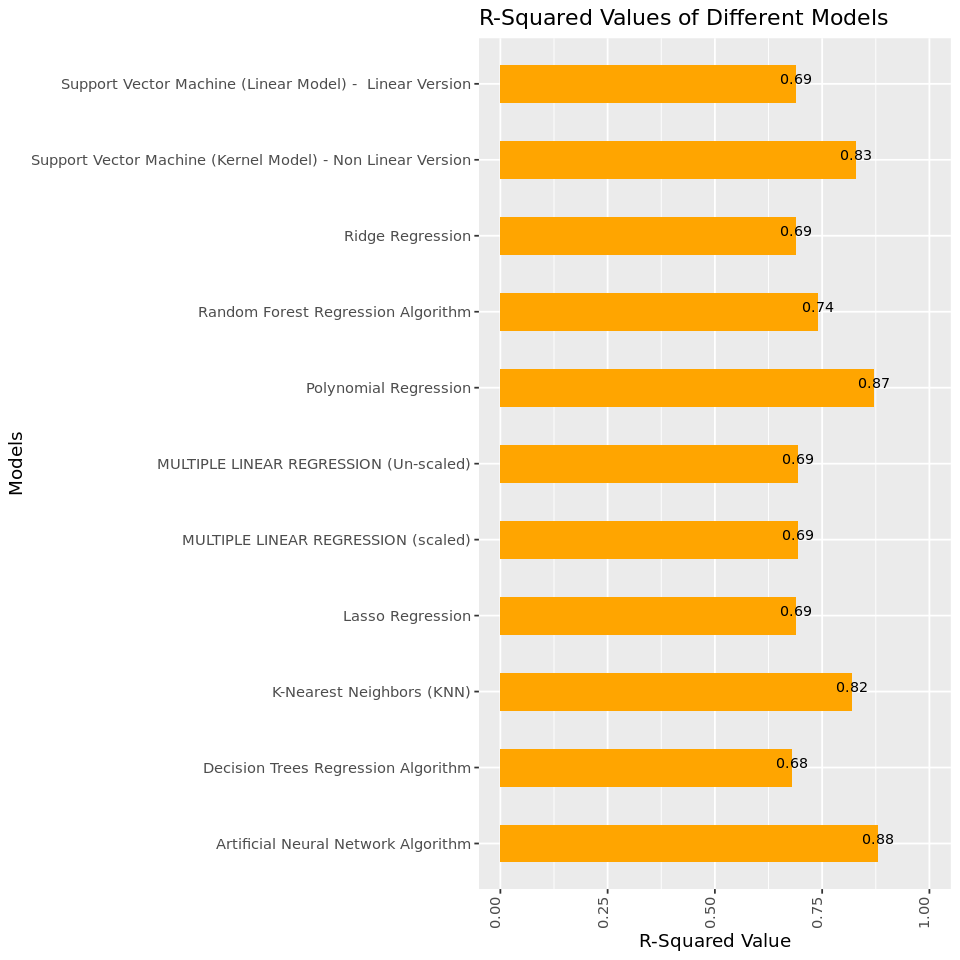

In [0]:
%r
library(ggplot2)

# Your data
All_Models_plot <- data.frame(
  Models = c('MULTIPLE LINEAR REGRESSION (Un-scaled)', 'MULTIPLE LINEAR REGRESSION (scaled)','Decision Trees Regression Algorithm',
           'Random Forest Regression Algorithm','Support Vector Machine (Kernel Model) - Non Linear Version',
           'Support Vector Machine (Linear Model) -  Linear Version','Artificial Neural Network Algorithm','K-Nearest Neighbors (KNN)',
           'Polynomial Regression','Lasso Regression','Ridge Regression'),
  R_Squared = c(0.694, 0.694, 0.68, 0.74, 0.83, 0.69, 0.88, 0.82, 0.87, 0.69, 0.69)
)

# Plotting using ggplot2
ggplot(All_Models_plot, aes(x = Models, y = R_Squared)) +
  geom_bar(stat = "identity", fill = "orange", width = 0.5) +
  geom_text(aes(label = sprintf("%.2f", R_Squared)), vjust = 0, size = 3) +
  labs(x = "Models", y = "R-Squared Value", title = "R-Squared Values of Different Models") +
  theme(axis.text.x = element_text(angle = 90, vjust = 0, hjust = 1)) +
  coord_flip() +
  ylim(0, 1) 
